# this notebook further refined the stem cell population based on Lgr5 expression and subsequent analysis after defining the stem cells
- subsequent analysis: DGE between WT and Mut stem cell populations 
- GSEA based on the DGE gene lists

In [8]:
import scanpy as sc 
import numpy as np
import pandas as pd
import os
import sys
from matplotlib import pyplot as plt
import anndata as ad


In [9]:
import seaborn as sn

In [10]:
sys.path.append("/home/lucy/star_proto_filter/")
sys.path.append("/home/lucy/")
sys.path.append("/home/lucy/AmbientContaminationMetrics/")
#sys.path.append("/home/lucy/quality/plot_quality_score.py")


In [11]:
import zc_filter_function as zc_filter
import quality_control_function as zc_qc
import plot_quality_score as qc_plt
import zc_function as zc

In [12]:
filtered_data_dir = '/home/lucy/Dropbox (VU Basic Sciences)/random_data_check/filtered_data/'

In [13]:
qc_strings = ['total_counts',
 'n_genes_by_counts',
 'pct_counts_in_top_200_genes',
 'pct_counts_Mitochondrial',]

In [14]:
new_marker_ls = ['Lgr5', 'Sox9','Ascl2', 'Mki67','Pcna', 'Olfm4',
                  'Lct', 'Krt20', 'Muc2','Tff3', 
                 'Ptprc',  'Pou2f3', 'Dclk1', 'Chga', 'Lyz1']

## load dataset

In [86]:
filenames = [f'10868_{i+1}.h5ad' for i in range(5) ]

In [87]:
dat_ls = []

In [88]:
for f in filenames:
    d = sc.read("./new_sample_10868_filtered/" + f )
    print(f)
    print( d.X.sum(axis = 1)[0:5] )
    d.raw = d.copy()
    dat_ls.append(d)

10868_1.h5ad
[80471. 75901. 70469. 67803. 65841.]
10868_2.h5ad
[55894. 53991. 53560. 49773. 47660.]
10868_3.h5ad
[40038. 38935. 33323. 30162. 29648.]
10868_4.h5ad
[40038. 38935. 33323. 31530. 30162.]
10868_5.h5ad
[65981. 59557. 53141. 50763. 49964.]


## re-annotate datasets

In [11]:
for d in dat_ls:
    ret = zc.normalization( d)

### dataset 1

In [12]:
dat1 = dat_ls[0]

In [13]:
dat1

AnnData object with n_obs × n_vars = 3273 × 23312
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_Mitochondrial', 'log1p_total_counts_Mitochondrial', 'pct_counts_Mitochondrial', 'leiden', 'cell_type', 'treatment', 'cell_type_old', 'old_cell_type2', 'cytotrace'
    var: 'Mitochondrial', 'ambient', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'cell_type_clusters', 'cell_type_colors', 'leiden', 'leiden_colors', 'neighbors', 'paneth', 'pca', 'rank_genes_groups', 'sample_colors', 'treatment_colors', 'umap', 'unknown_clusters'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'connectivities', 'distances'

In [28]:
#ret = zc.normalization( dat1)

/home/lucy/.local/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


In [14]:
sc.tl.leiden( dat1, resolution=1.8)

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


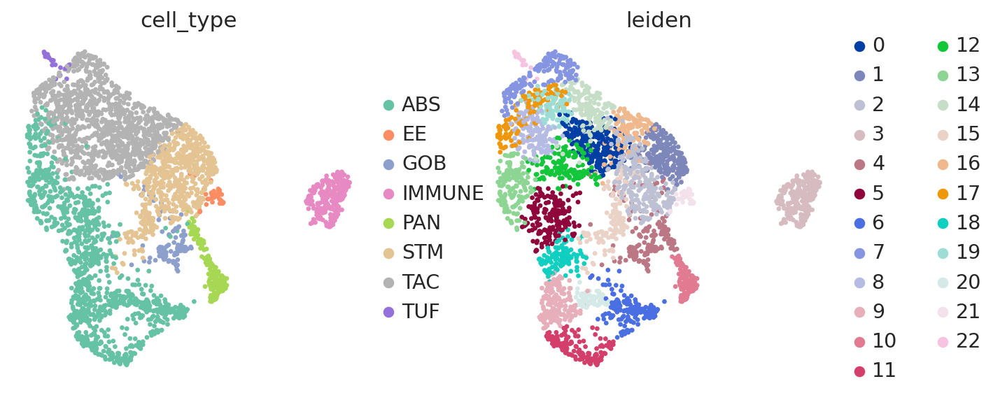

In [15]:
sc.pl.umap(dat1, color = ['cell_type' , 'leiden']  )

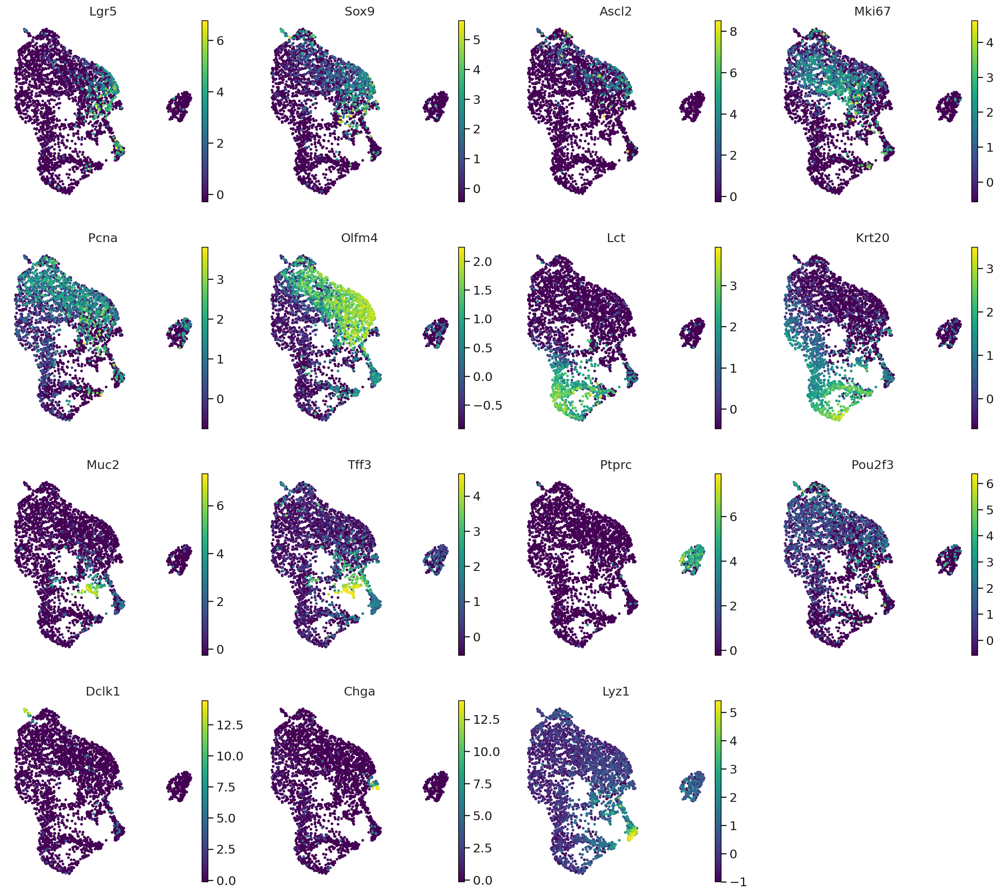

In [27]:
sc.pl.umap(dat1, color = new_marker_ls, use_raw = False,  )

change leiden 15 to TAC

In [16]:
dat1a = zc_filter.annotate_clusters( dat1, from_label=pd.Series([15]).astype(str), new_label='TAC' )

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


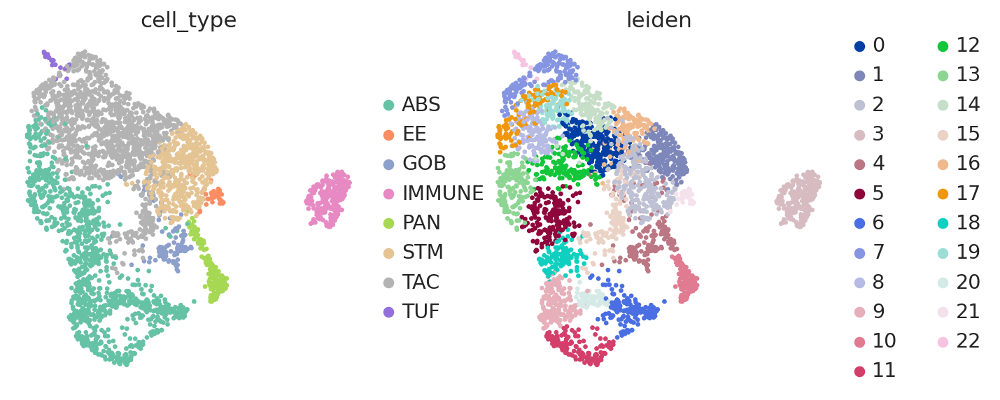

In [17]:
sc.pl.umap(dat1a, color = ['cell_type' , 'leiden']  )

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


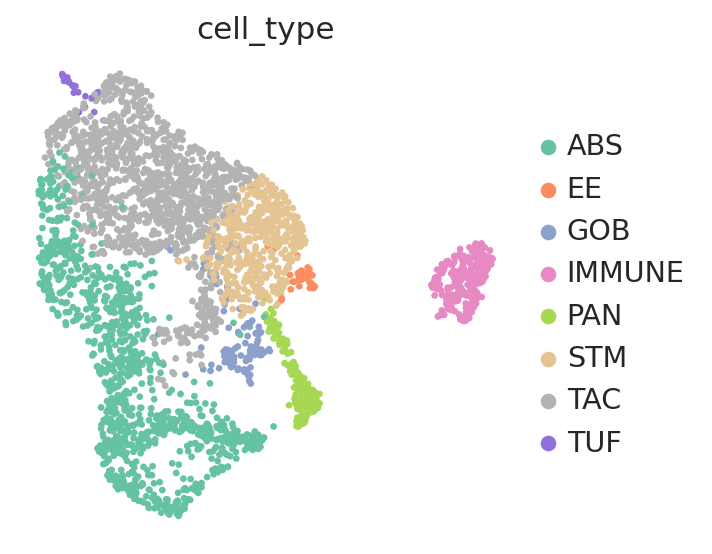

In [50]:
sc.pl.umap(dat1a, color = ['cell_type' ]  )

### data2

In [19]:
dat2 = dat_ls[1]

In [20]:
dat2

AnnData object with n_obs × n_vars = 4324 × 23312
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_Mitochondrial', 'log1p_total_counts_Mitochondrial', 'pct_counts_Mitochondrial', 'leiden', 'cell_type', 'treatment', 'cell_type_old', 'old_cell_type2', 'cytotrace'
    var: 'Mitochondrial', 'ambient', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'cell_type_clusters', 'cell_type_colors', 'leiden', 'leiden_colors', 'neighbors', 'paneth', 'pca', 'sample_colors', 'treatment_colors', 'umap', 'unknown_clusters'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'connectivities', 'distances'

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


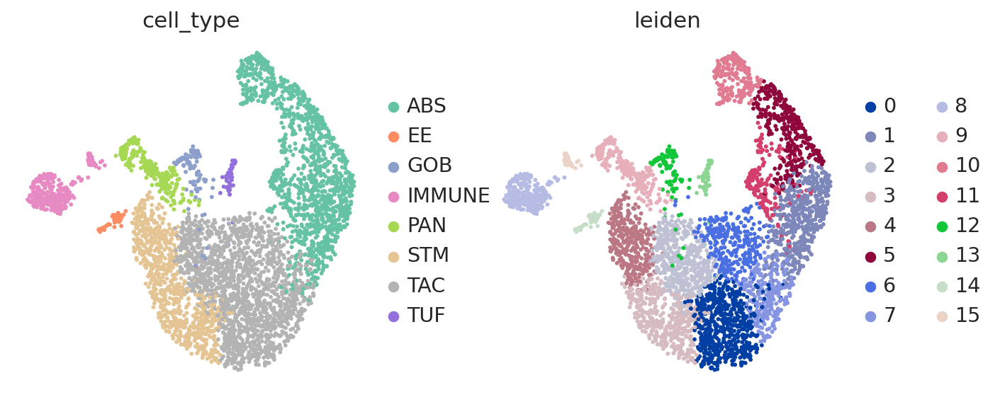

In [21]:
sc.pl.umap(dat2, color = ['cell_type' , 'leiden']  )

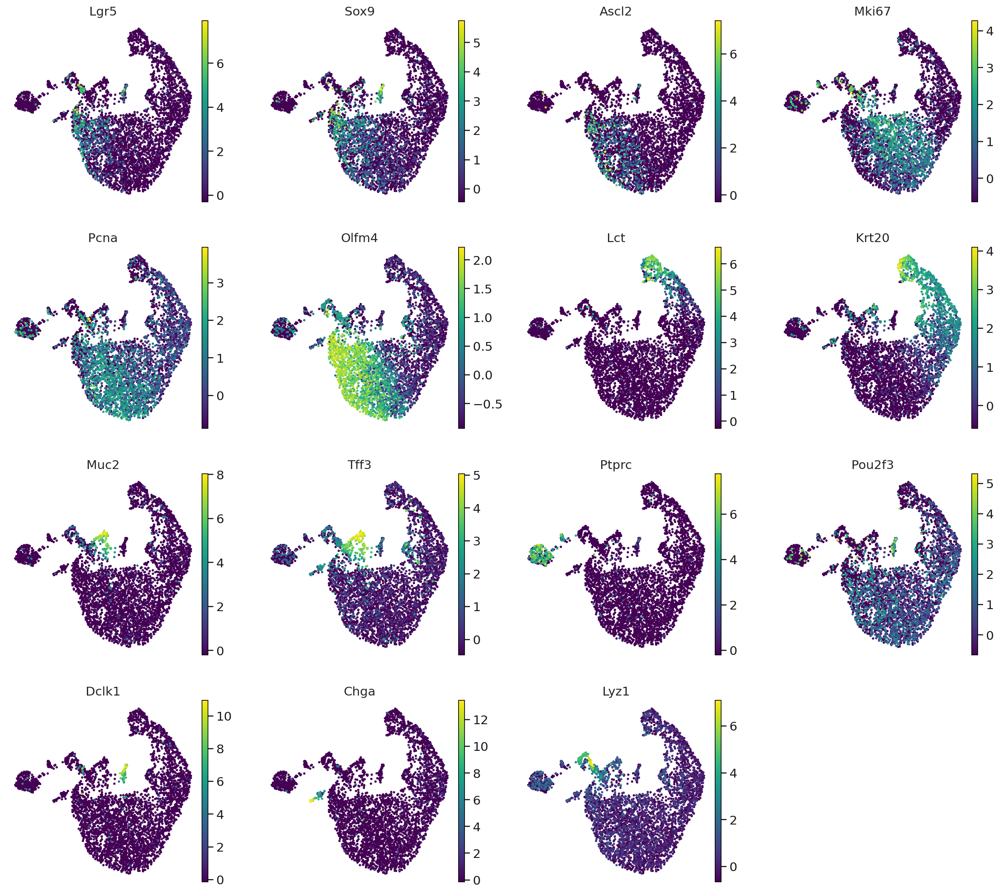

In [42]:
sc.pl.umap(dat2, color = new_marker_ls, use_raw = False,  )

change leiden 3 to TAC

In [22]:
dat2a = zc_filter.annotate_clusters( dat2, from_label=pd.Series([3]).astype(str), new_label='TAC' )

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


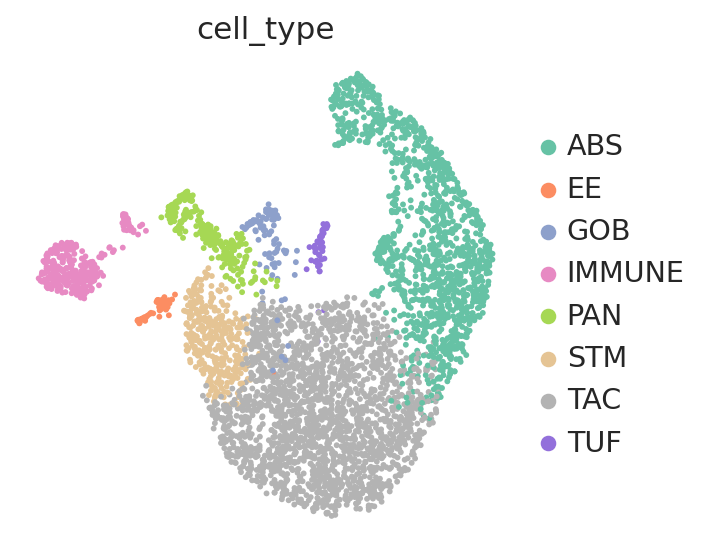

In [23]:
sc.pl.umap(dat2a, color = ['cell_type' ]  )

### data 3

In [24]:
dat3 = dat_ls[2]

In [25]:
dat3

AnnData object with n_obs × n_vars = 4996 × 23312
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_Mitochondrial', 'log1p_total_counts_Mitochondrial', 'pct_counts_Mitochondrial', 'leiden', 'cell_type', 'treatment', 'cell_type_old', 'leiden1.5', 'cytotrace'
    var: 'Mitochondrial', 'ambient', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'cell_type_clusters', 'cell_type_colors', 'leiden', 'leiden1.5_colors', 'leiden_colors', 'neighbors', 'paneth', 'pca', 'sample_colors', 'treatment_colors', 'umap', 'unknown_clusters'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'connectivities', 'distances'

In [26]:
sc.tl.leiden( dat3, resolution=1.8)

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


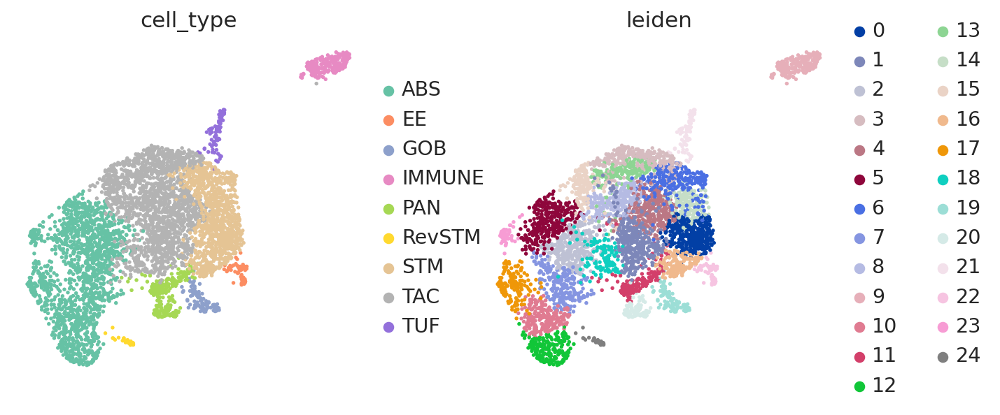

In [27]:
sc.pl.umap(dat3, color = ['cell_type' , 'leiden']  )

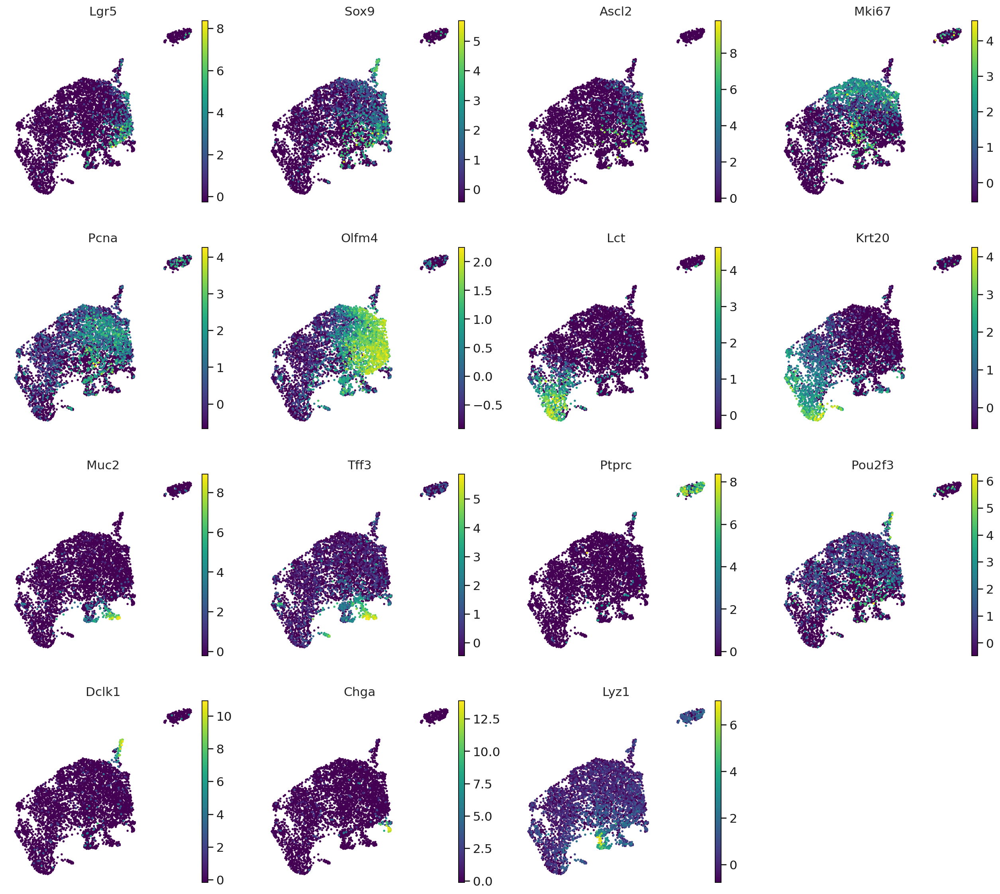

In [48]:
sc.pl.umap(dat3, color = new_marker_ls, use_raw = False,  )

within current stem cell cluster, label STM if Lgr5> 5, else TAC

In [28]:
dat3.obs['Lgr5_plus'] = dat3.to_df()['Lgr5'] > 1
dat3.obs['Lgr5_plus'] = dat3.obs['Lgr5_plus'].astype(str)

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


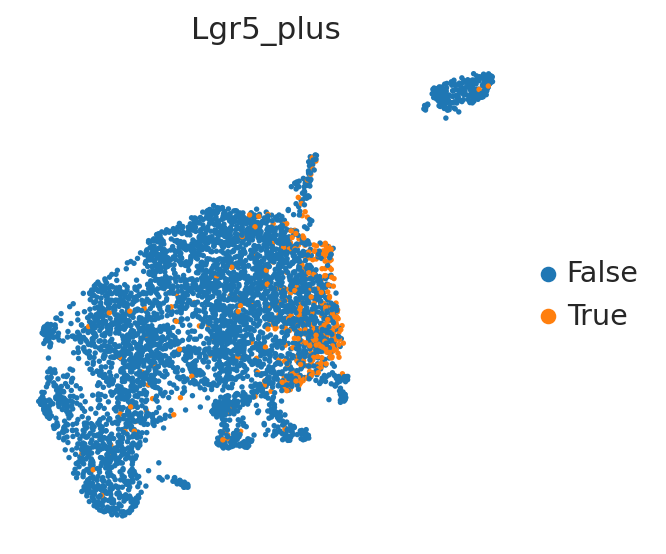

In [29]:
sc.pl.umap(dat3, color=['Lgr5_plus'] )

In [30]:
new_cell_type = []
for i in range( dat3.n_obs):
    if( dat3.obs.iloc[i]["cell_type"] == 'STM'):
        if( dat3.obs.iloc[i]["Lgr5_plus"] == 'True' ):
            new_cell_type.append( 'STM')
        else:
            new_cell_type.append( 'TAC' )
    else:
        new_cell_type.append( dat3.obs.iloc[i]["cell_type"] )
    

In [31]:
dat3.obs['new_cell_type'] = new_cell_type

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


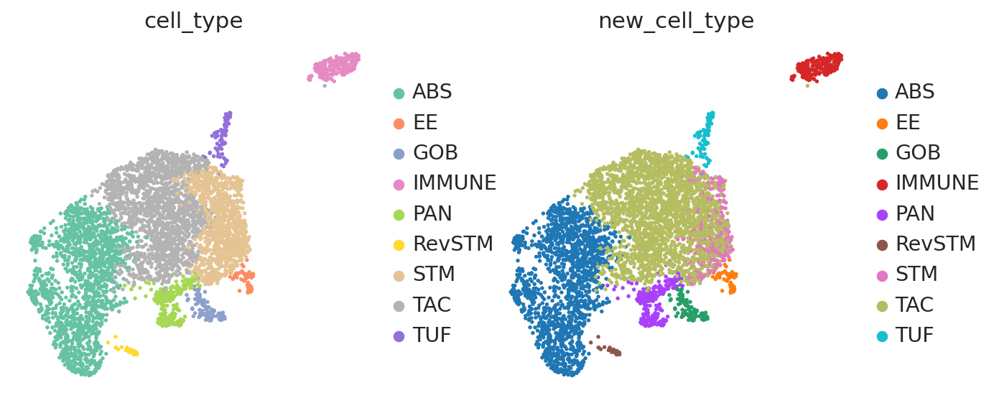

In [32]:
sc.pl.umap(dat3, color = ['cell_type' , 'new_cell_type']  )

In [33]:
dat3.obs['old_cell_type'] = dat3.obs['cell_type'].copy()

In [34]:
dat3.obs['cell_type'] = dat3.obs['new_cell_type']

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


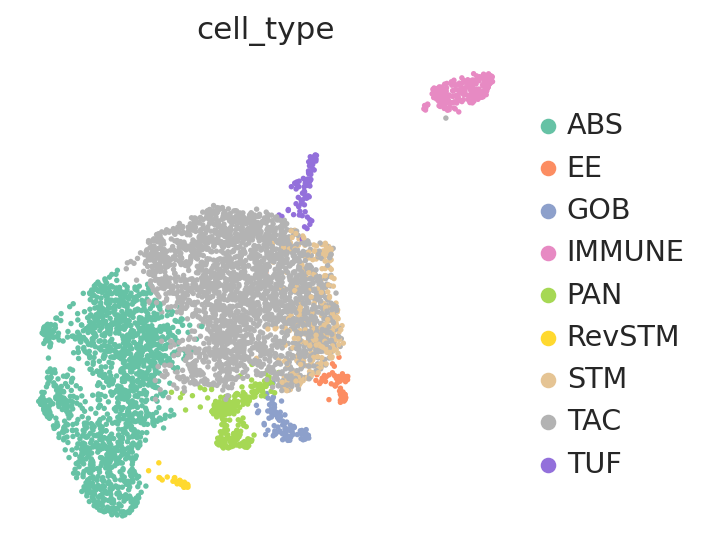

In [35]:
sc.pl.umap(dat3, color = ['cell_type']  )

### data 5

In [36]:
dat5 = dat_ls[4]

In [37]:
dat5

AnnData object with n_obs × n_vars = 4505 × 23312
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_Mitochondrial', 'log1p_total_counts_Mitochondrial', 'pct_counts_Mitochondrial', 'leiden', 'cell_type', 'treatment', 'cell_type_old', 'cytotrace'
    var: 'Mitochondrial', 'ambient', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'cell_type_clusters', 'cell_type_colors', 'leiden', 'leiden_colors', 'neighbors', 'paneth', 'pca', 'sample_colors', 'treatment_colors', 'umap', 'unknown_clusters'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'connectivities', 'distances'

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


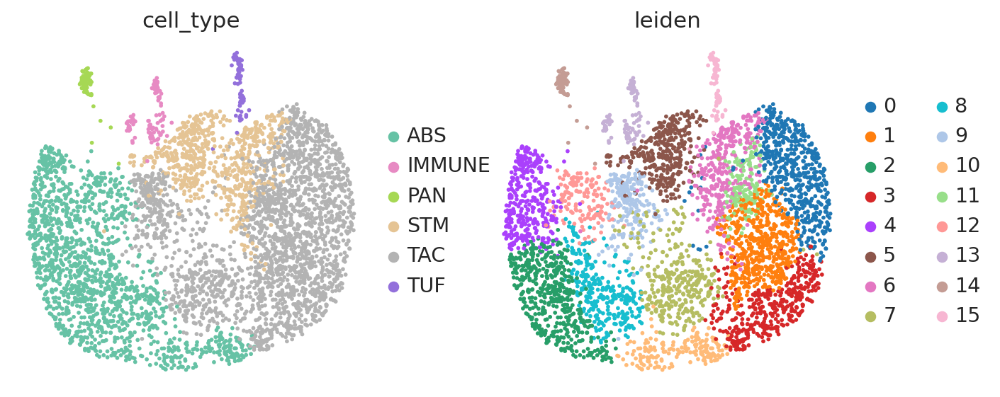

In [38]:
sc.pl.umap(dat5, color = ['cell_type' , 'leiden']  )

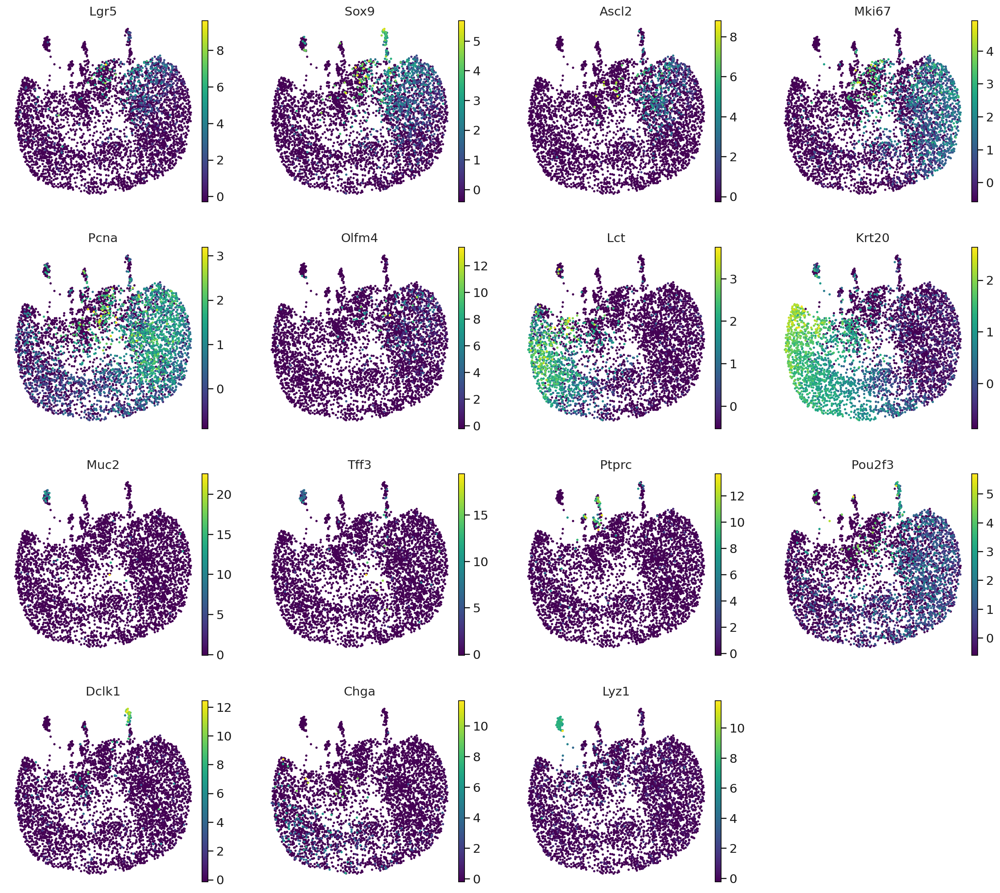

In [81]:
sc.pl.umap(dat5, color = new_marker_ls, use_raw = False,  )

No Change

## combine the 3 valid data and subsamples
- combine the 4 datasets ( remove dataset 4)  and check MTGR1 expression
- subsample the 3 WT samples so that WT and Mut conditions have the same number of cells 

In [96]:
#dat_ls2 = [dat1a, dat2a, dat3, dat5]
dat_ls2 = dat_ls[0:3] + [dat_ls[4]]

In [97]:
refined_comb = ad.concat( dat_ls2, )

In [98]:
refined_comb

AnnData object with n_obs × n_vars = 17098 × 23312
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_Mitochondrial', 'log1p_total_counts_Mitochondrial', 'pct_counts_Mitochondrial', 'leiden', 'cell_type', 'treatment', 'cell_type_old', 'cytotrace'
    obsm: 'X_pca', 'X_umap'
    layers: 'arcsinh', 'raw_counts'

In [99]:
refined_comb.obs = refined_comb.obs[['sample',  'cell_type', 'cytotrace', 'treatment']]

In [100]:
refined_comb.X.sum(axis = 1)

array([80471., 75901., 70469., ...,   887.,   885.,   883.], dtype=float32)

In [101]:
refined_comb.raw = refined_comb.copy()

In [102]:
ret = zc.normalization( refined_comb) 

In [103]:
zc.clustering( refined_comb)

/home/lucy/.local/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### plot Mtgr1

In [60]:
refined_comb.var_names[ refined_comb.var_names.str.startswith('Cbf') ] 

Index(['Cbfa2t2', 'Cbfb', 'Cbfa2t3'], dtype='object', name='Genes')

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


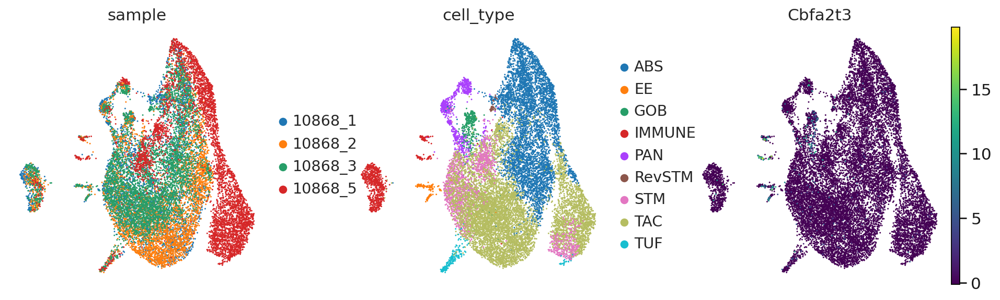

In [64]:
sc.pl.umap(refined_comb, color = ['sample', 'cell_type', 'Cbfa2t3', ], use_raw = False)

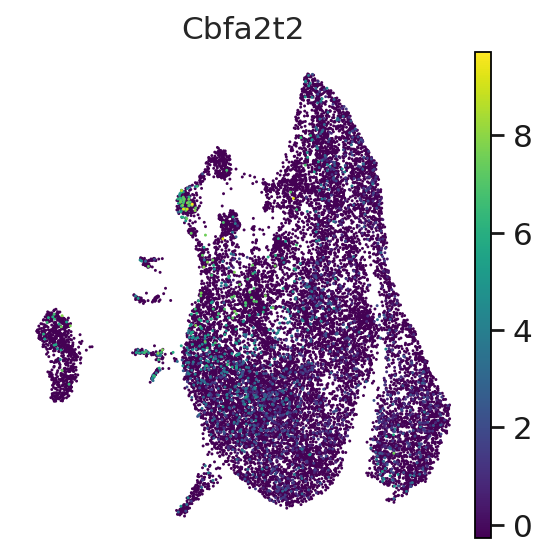

In [65]:
sc.pl.umap(refined_comb, color = [ 'Cbfa2t2', ], use_raw = False)

In [104]:
temp = refined_comb[refined_comb.obs['sample'] != '10868_5' ]

In [105]:
temp.X.sum(axis = 1)

array([  995.7981,  1001.729 ,  1553.6068, ..., -1422.43  , -1280.2255,
       -1352.7621], dtype=float32)

In [106]:
temp.X = temp.raw.X

In [107]:
# ret = zc.normalization( temp)
# zc.clustering( temp) 

In [108]:
#sc.pl.umap(temp, color = [ 'Cbfa2t2', 'Cbfa2t3', 'sample', 'cell_type'], use_raw = False, ncols = 2)

## subsample combined dataset to keep WT and MUT comparable data size

In [109]:
dat5 = dat_ls[4]

In [110]:
dat5.n_obs # 4505 cells

4505

In [111]:
dat5.X.sum( axis = 1)

array([65981., 59557., 53141., ...,   887.,   885.,   883.], dtype=float32)

In [112]:
temp.X = temp.raw.X

In [113]:
subset_WT = sc.pp.subsample( temp, n_obs = dat5.n_obs , copy = True)

In [114]:
subset_WT

AnnData object with n_obs × n_vars = 4505 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'treatment'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'distances', 'connectivities'

In [115]:
subset_WT.X.sum(axis = 1)

array([ 2377.,  1005., 12946., ...,  3675., 14097., 13551.], dtype=float32)

In [116]:
subsampled_comb = ad.concat( [subset_WT, dat5] ) 

In [117]:
subsampled_comb

AnnData object with n_obs × n_vars = 9010 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'treatment'
    obsm: 'X_pca', 'X_umap'
    layers: 'arcsinh', 'raw_counts'

In [118]:
subsampled_comb.X.sum(axis = 1)

array([ 2377.,  1005., 12946., ...,   887.,   885.,   883.], dtype=float32)

In [119]:
subsampled_comb.raw = subsampled_comb.copy()

In [120]:
subsampled_comb.raw = subsampled_comb.copy()
ret = zc.normalization( subsampled_comb)
zc.clustering( subsampled_comb)

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


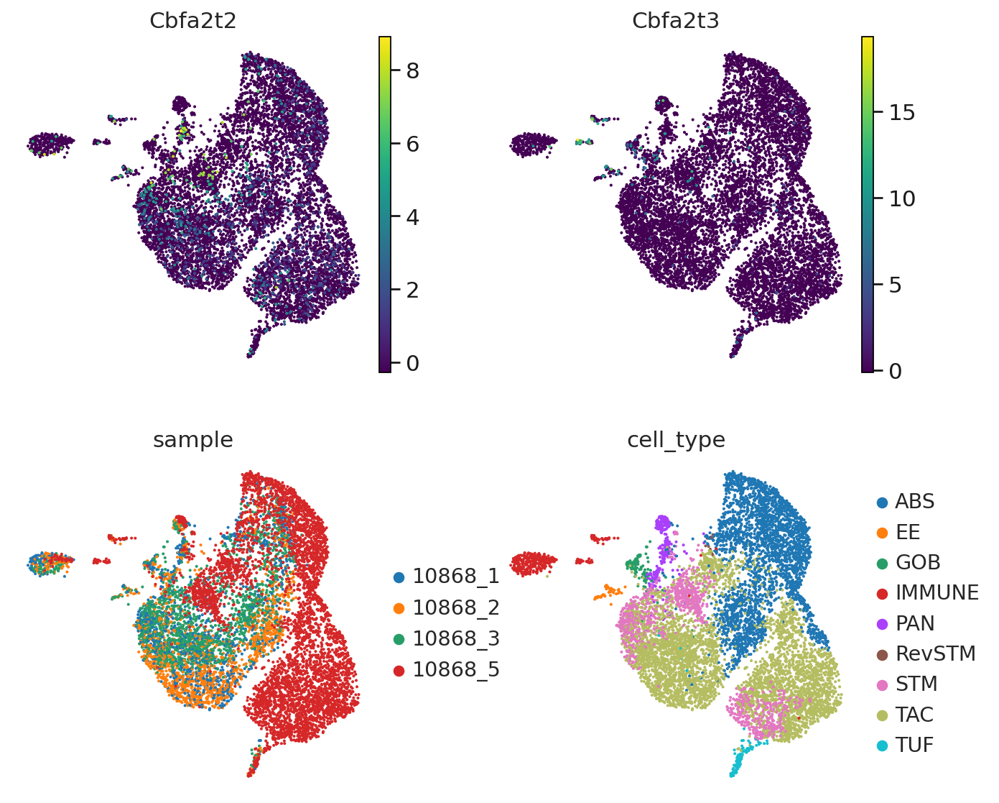

In [121]:
sc.pl.umap(subsampled_comb, color = [ 'Cbfa2t2', 'Cbfa2t3', 'sample', 'cell_type'], use_raw = False, ncols = 2)

#### annotate immune cell population and change treatment labels

In [122]:
zc_filter.mouse_non_epi

{'T': ['Cd3d', 'Cd4', 'Trbc2', 'Cd96', 'Cd247'],
 'MYE': ['Csf1r', 'Csf3r', 'Cd14', 'Mrc1'],
 'MAS': ['Kit', 'Krt1'],
 'B': ['Cd19', 'Ms4a1'],
 'PLAS': ['Igha1', 'Igha2', 'Jchain'],
 'END': ['Vwf', 'Mcam'],
 'FIB': ['Col1a1', 'Fn1']}

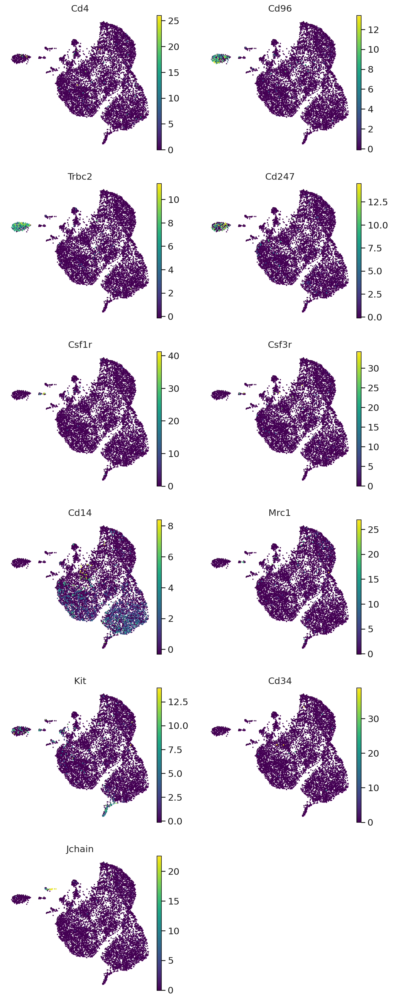

In [128]:
sc.pl.umap(subsampled_comb, color = [ 'Cd4', 'Cd96',  'Trbc2',  'Cd247',
                                     'Csf1r', 'Csf3r', 'Cd14', 'Mrc1',
                                    'Kit' ,  'Cd34', 'Jchain'], use_raw = False, ncols = 2)

In [129]:
subsampled_comb

AnnData object with n_obs × n_vars = 9010 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'treatment'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap', 'sample_colors', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'distances', 'connectivities'

In [135]:
sc.tl.leiden( subsampled_comb, resolution=1.8)

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


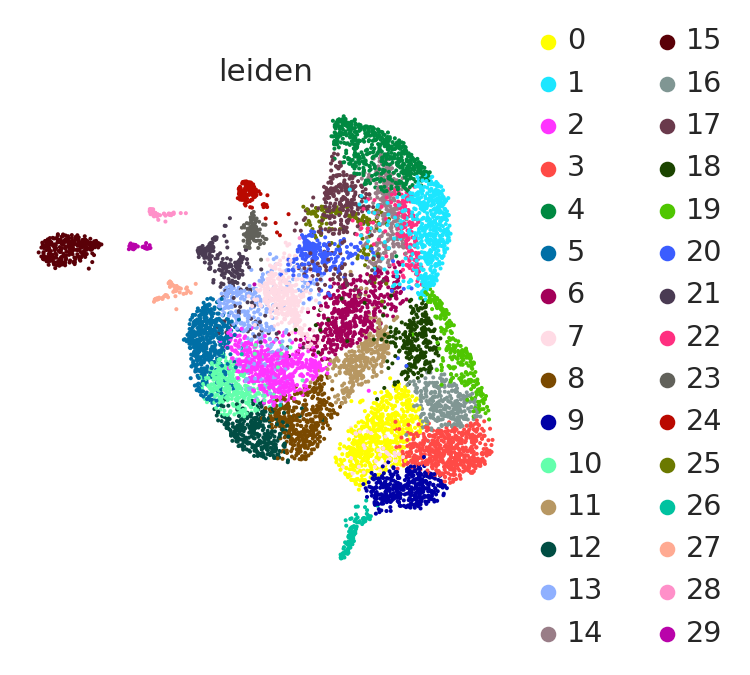

In [136]:
sc.pl.umap( subsampled_comb, color = 'leiden' )

In [137]:
relab = zc_filter.annotate_clusters( subsampled_comb, ['15'], 'TCell', )

In [141]:
relab = zc_filter.annotate_clusters( relab, ['29'], 'MYE', )
relab = zc_filter.annotate_clusters( relab, ['28'], 'PLASM', )

In [143]:
subsampled_comb

AnnData object with n_obs × n_vars = 9010 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'treatment', 'leiden'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap', 'sample_colors', 'cell_type_colors', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'distances', 'connectivities'

In [150]:
sorted_ccellTYpe = list( subsampled_comb.obs['cell_type'].unique().categories )

In [144]:
subsampled_comb.uns['cell_type_colors' ]

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf']

In [151]:
clr_dict = dict( zip(sorted_ccellTYpe, subsampled_comb.uns['cell_type_colors' ] ))

In [152]:
clr_dict['TCell'] = '#aec7e8'
clr_dict['MYE'] = '#ffbb78'
clr_dict['PLASM'] = '#98df8a'

In [147]:
relab.obs['cell_type'].unique().categories

Index(['ABS', 'EE', 'GOB', 'IMMUNE', 'MYE', 'PAN', 'PLASM', 'RevSTM', 'STM',
       'TAC', 'TCell', 'TUF'],
      dtype='object')

In [153]:
new_clr = [clr_dict[cell] for cell in relab.obs['cell_type'].unique().categories ]

In [154]:
new_clr

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#ffbb78',
 '#aa40fc',
 '#98df8a',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#aec7e8',
 '#17becf']

In [155]:
relab.uns['cell_type_colors' ] = new_clr

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


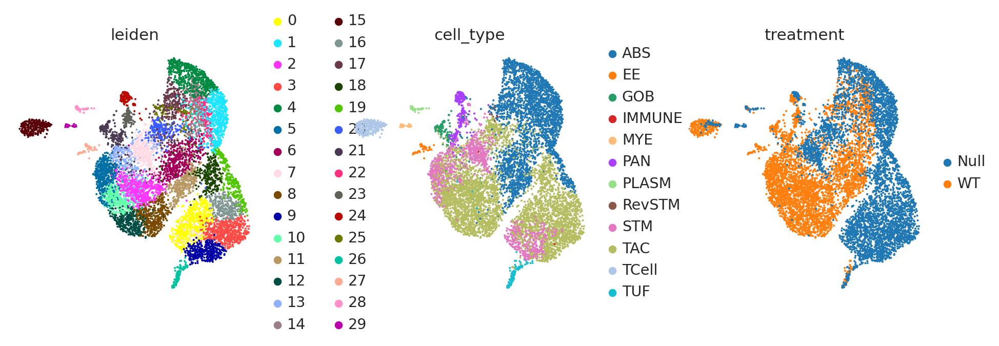

In [157]:
sc.pl.umap( relab, color = ['leiden', 'cell_type', 'treatment'] )

In [159]:
new_treatment = relab.obs['treatment'].replace( 'Null', 'Mtgr1 -/-' ) 

In [160]:
relab.obs['condition' ] = new_treatment

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


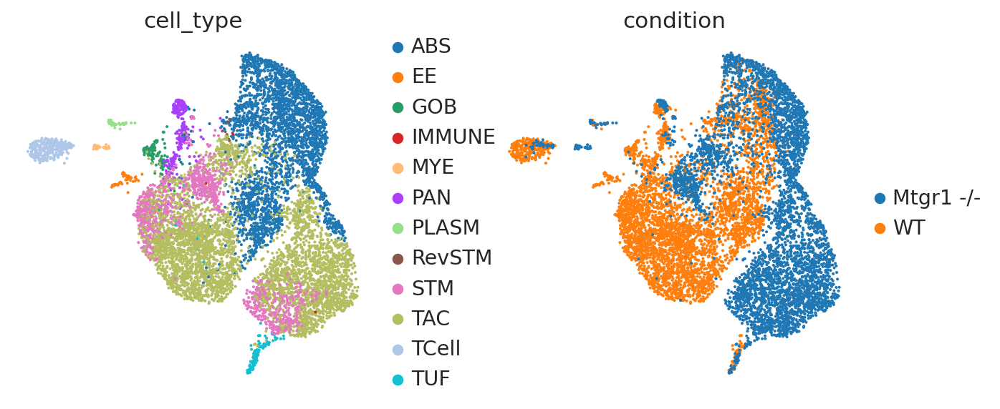

In [162]:
sc.pl.umap( relab, color = [ 'cell_type', 'condition'] )

## Stem cell functional analysis 

In [88]:
#subsampled_comb.X.sum(axis = 1)

### DGE

compare differentia genes between the two stem cell population

In [89]:
treatment = ['WT' for i in range(4) ]
treatment[-1] = 'Mut'

In [90]:
treatment

['WT', 'WT', 'WT', 'Mut']

In [92]:
treatment_dict = dict( zip (list( subsampled_comb.obs['sample'].unique()), treatment))

In [93]:
treatment_dict

{'10868_3': 'WT', '10868_1': 'WT', '10868_2': 'WT', '10868_5': 'Mut'}

In [94]:
subsampled_comb.obs['treatment'] = [ treatment_dict[s] for s in subsampled_comb.obs['sample'] ] 

In [95]:
stm = subsampled_comb[subsampled_comb.obs['cell_type'] == 'STM' ] 

In [96]:
stm

View of AnnData object with n_obs × n_vars = 1052 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'treatment'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap', 'sample_colors', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'distances', 'connectivities'

In [101]:
sc.tl.rank_genes_groups( stm, groupby='treatment',  reference= 'WT', use_raw= False, layer='arcsinh', method = 'wilcoxon', key_added='stem_DGE' , )

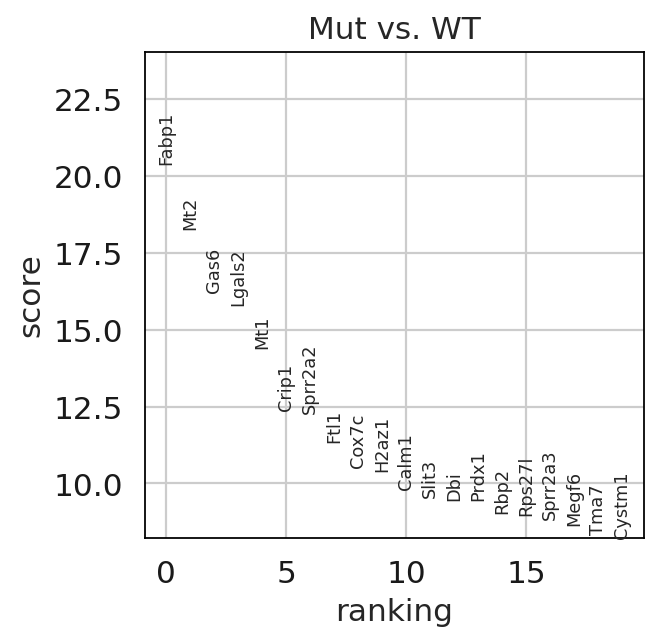

In [102]:
sc.pl.rank_genes_groups( stm, key='stem_DGE' )

In [103]:
sc.tl.rank_genes_groups( stm, groupby='treatment',  reference= 'Mut', use_raw= False, layer='arcsinh', method = 'wilcoxon', key_added='stem_DGE_inverse' , )

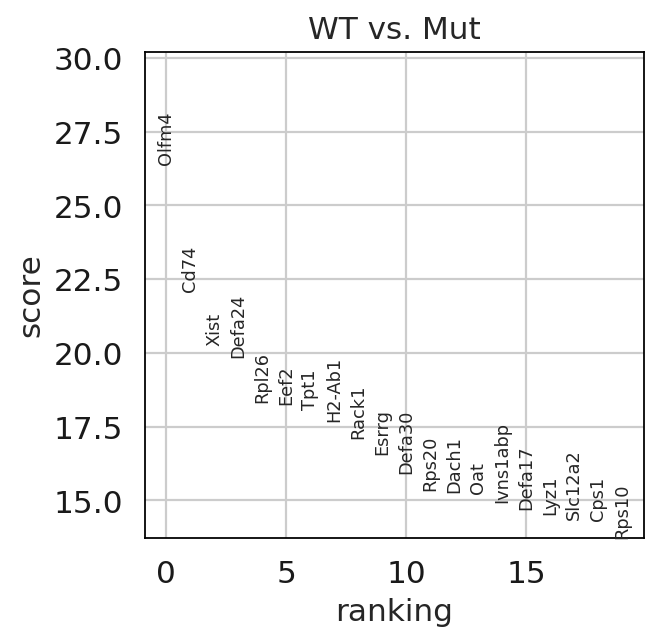

In [104]:
sc.pl.rank_genes_groups( stm, key='stem_DGE_inverse' )

In [106]:
stm.obs['treatment'].value_counts()

treatment
Mut    668
WT     384
Name: count, dtype: int64

In [107]:
stm.obs['sample'].value_counts()

sample
10868_5    668
10868_1    157
10868_2    126
10868_3    101
Name: count, dtype: int64

In [108]:
stm

AnnData object with n_obs × n_vars = 1052 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'treatment'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap', 'sample_colors', 'cell_type_colors', 'stem_DGE', 'stem_DGE_inverse'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'distances', 'connectivities'

In [109]:
rank_gene_dict = stm.uns['stem_DGE']

In [112]:
rank_gene_dict

{'params': {'groupby': 'treatment',
  'reference': 'WT',
  'method': 'wilcoxon',
  'use_raw': False,
  'layer': 'arcsinh',
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('Fabp1',), ('Mt2',), ('Gas6',), ..., ('Xist',), ('Cd74',),
            ('Olfm4',)],
           dtype=[('Mut', 'O')]),
 'scores': rec.array([( 20.383898,), ( 18.259796,), ( 16.218529,), ...,
            (-20.275032,), (-22.094563,), (-26.409687,)],
           dtype=[('Mut', '<f4')]),
 'pvals': rec.array([(2.32390066e-092,), (1.72936022e-074,), (3.73021381e-059,),
            ..., (2.13652863e-091,), (3.56511928e-108,),
            (1.06052521e-153,)],
           dtype=[('Mut', '<f8')]),
 'pvals_adj': rec.array([(1.80582574e-088,), (5.03935569e-071,), (6.68913418e-056,),
            ..., (1.24516889e-087,), (4.15550303e-104,),
            (2.47229638e-149,)],
           dtype=[('Mut', '<f8')]),
 'logfoldchanges': rec.array([(  3.8990242,), (  4.100955 ,), (  3.635256 ,), ...,
            (-31.4356   ,), ( 

In [115]:
dge_res = zc.parse_rank_gene_group_dict(rank_gene_dict, fields_to_keep = ['logfoldchanges', 'pvals_adj', 'pvals', 'names', 'scores'], 
                               condition = 'Mut', sort_by = 'scores', ascending = True)

### GSEA

In [15]:
import gseapy as gp

#### Get Gene sets

In [16]:
names = pd.Series( gp.get_library_name() ) 

In [13]:
len(names)

224

In [183]:
names[0:50]

0                                  ARCHS4_Cell-lines
1                                   ARCHS4_IDG_Coexp
2                               ARCHS4_Kinases_Coexp
3                                   ARCHS4_TFs_Coexp
4                                     ARCHS4_Tissues
5                          Achilles_fitness_decrease
6                          Achilles_fitness_increase
7                  Aging_Perturbations_from_GEO_down
8                    Aging_Perturbations_from_GEO_up
9                   Allen_Brain_Atlas_10x_scRNA_2021
10                            Allen_Brain_Atlas_down
11                              Allen_Brain_Atlas_up
12                                      Azimuth_2023
13                           Azimuth_Cell_Types_2021
14                                     BioCarta_2013
15                                     BioCarta_2015
16                                     BioCarta_2016
17                                    BioPlanet_2019
18                                      BioPle

In [184]:
names[50:100]

50                              ENCODE_TF_ChIP-seq_2015
51            ENCODE_and_ChEA_Consensus_TFs_from_ChIP-X
52                                               ESCAPE
53                          Elsevier_Pathway_Collection
54                 Enrichr_Libraries_Most_Popular_Genes
55              Enrichr_Submissions_TF-Gene_Coocurrence
56                 Enrichr_Users_Contributed_Lists_2020
57                      Epigenomics_Roadmap_HM_ChIP-seq
58                               FANTOM6_lncRNA_KD_DEGs
59                           GO_Biological_Process_2013
60                           GO_Biological_Process_2015
61                           GO_Biological_Process_2017
62                          GO_Biological_Process_2017b
63                           GO_Biological_Process_2018
64                           GO_Biological_Process_2021
65                           GO_Biological_Process_2023
66                           GO_Cellular_Component_2013
67                           GO_Cellular_Compone

In [185]:
names[100:150]

100                               HumanCyc_2015
101                               HumanCyc_2016
102                            Human_Gene_Atlas
103                    Human_Phenotype_Ontology
104                       IDG_Drug_Targets_2022
105                       InterPro_Domains_2019
106                         Jensen_COMPARTMENTS
107                             Jensen_DISEASES
108                              Jensen_TISSUES
109                                    KEA_2013
110                                    KEA_2015
111                                   KEGG_2013
112                                   KEGG_2015
113                                   KEGG_2016
114                             KEGG_2019_Human
115                             KEGG_2019_Mouse
116                             KEGG_2021_Human
117                 KOMP2_Mouse_Phenotypes_2022
118          Kinase_Perturbations_from_GEO_down
119            Kinase_Perturbations_from_GEO_up
120    L1000_Kinase_and_GPCR_Perturbatio

In [187]:
names[150:200]

150                                      NCI-Nature_2016
151       NIH_Funded_PIs_2017_AutoRIF_ARCHS4_Predictions
152       NIH_Funded_PIs_2017_GeneRIF_ARCHS4_Predictions
153                    NIH_Funded_PIs_2017_Human_AutoRIF
154                    NIH_Funded_PIs_2017_Human_GeneRIF
155                    NURSA_Human_Endogenous_Complexome
156                                         OMIM_Disease
157                                        OMIM_Expanded
158                                        Old_CMAP_down
159                                          Old_CMAP_up
160                              Orphanet_Augmented_2021
161                                       PFOCR_Pathways
162                                  PFOCR_Pathways_2023
163                                     PPI_Hub_Proteins
164                             PanglaoDB_Augmented_2021
165                                         Panther_2015
166                                         Panther_2016
167                            

In [122]:
names[names.str.startswith( 'GO') ]

59     GO_Biological_Process_2013
60     GO_Biological_Process_2015
61     GO_Biological_Process_2017
62    GO_Biological_Process_2017b
63     GO_Biological_Process_2018
64     GO_Biological_Process_2021
65     GO_Biological_Process_2023
66     GO_Cellular_Component_2013
67     GO_Cellular_Component_2015
68     GO_Cellular_Component_2017
69    GO_Cellular_Component_2017b
70     GO_Cellular_Component_2018
71     GO_Cellular_Component_2021
72     GO_Cellular_Component_2023
73     GO_Molecular_Function_2013
74     GO_Molecular_Function_2015
75     GO_Molecular_Function_2017
76    GO_Molecular_Function_2017b
77     GO_Molecular_Function_2018
78     GO_Molecular_Function_2021
79     GO_Molecular_Function_2023
dtype: object

In [123]:
names[names.str.startswith( 'MSig') ]

140           MSigDB_Computational
141           MSigDB_Hallmark_2020
142    MSigDB_Oncogenic_Signatures
dtype: object

In [124]:
names[names.str.startswith( 'KEGG') ]

111          KEGG_2013
112          KEGG_2015
113          KEGG_2016
114    KEGG_2019_Human
115    KEGG_2019_Mouse
116    KEGG_2021_Human
dtype: object

In [15]:
names[names.str.contains( 'Wiki') ]

213     WikiPathway_2021_Human
214     WikiPathway_2023_Human
215          WikiPathways_2013
216          WikiPathways_2015
217          WikiPathways_2016
218    WikiPathways_2019_Human
219    WikiPathways_2019_Mouse
dtype: object

In [17]:
gene_sets = [ 'GO_Biological_Process_2023', 'GO_Cellular_Component_2023', 'GO_Molecular_Function_2023', 
             'MSigDB_Hallmark_2020',  'KEGG_2019_Mouse', 'WikiPathways_2019_Mouse']

In [18]:
gene_sets2 = ['HDSigDB_Mouse_2021', 'HMDB_Metabolites', 'Mouse_Gene_Atlas', 'Reactome_2022', 'TF_Perturbations_Followed_by_Expression' ,'Reactome_2022',]

In [40]:
t5_gene_sets = [ 'GO_Biological_Process_2023', 'WikiPathways_2019_Mouse', 'KEGG_2019_Mouse']

In [19]:
sn.color_palette("Set2", len(gene_sets)).as_hex()

['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f']

In [20]:
clr = sn.color_palette("Set2", len(gene_sets)).as_hex()

In [21]:
color_dict = dict( zip(gene_sets,clr  ))

In [22]:
color_dict

{'GO_Biological_Process_2023': '#66c2a5',
 'GO_Cellular_Component_2023': '#fc8d62',
 'GO_Molecular_Function_2023': '#8da0cb',
 'MSigDB_Hallmark_2020': '#e78ac3',
 'KEGG_2019_Mouse': '#a6d854',
 'WikiPathways_2019_Mouse': '#ffd92f'}

In [43]:
sn.color_palette("Set2", len(t5_gene_sets)).as_hex()

['#66c2a5', '#fc8d62', '#8da0cb']

In [41]:
clr_t5 = sn.color_palette("Set2", len(t5_gene_sets)).as_hex()

In [42]:
color_dict_t5 = dict( zip(t5_gene_sets,clr_t5  ))

### Trial 1:  get gene lists from DGE
- sorted based on scores
- use top 200

In [237]:
dge_res.head() # MUT vs WT

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
0,3.899024,1.805826e-88,2.323901e-92,Fabp1,20.383898
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564013,4.989260e-84,1.070106e-87,Defa24,-19.851477


In [157]:
dge_res.sort_values( by='pvals_adj', ascending= True, inplace= True) 

In [158]:
dge_res.shape

(23312, 5)

In [159]:
dge_res2 = dge_res.iloc[0:500]

In [160]:
dge_res2[-10:-1]

,logfoldchanges,pvals_adj,pvals,names,scores
22926,-0.793284,0.000824,0.000017,Cnn3,-4.296577
22925,-1.339695,0.000854,0.000018,Slc39a5,-4.288146
105,0.441847,0.000855,0.000018,Hnrnpa3,4.286882
22924,-1.038190,0.000855,0.000018,Slc16a10,-4.287198
22923,-0.760244,0.000857,0.000018,Usp34,-4.285828
22922,-0.821692,0.000862,0.000018,Lrba,-4.283825
22921,-1.214086,0.000862,0.000018,Thra,-4.283720
22920,-0.683142,0.000869,0.000019,Slco2a1,-4.281507
22919,-0.736062,0.000893,0.000019,Dag1,-4.275078


In [161]:
mut_up = dge_res2.sort_values( by='scores', ascending= False, inplace= False) 

In [162]:
mut_up.head()

,logfoldchanges,pvals_adj,pvals,names,scores
0,3.899024,1.805826e-88,2.323901e-92,Fabp1,20.383898
1,4.100955,5.039356e-71,1.729360e-74,Mt2,18.259796
2,3.635256,6.689134e-56,3.730214e-59,Gas6,16.218529
3,1.381510,7.240207e-53,4.658678e-56,Lgals2,15.774528
4,2.006882,7.109687e-44,6.709554e-47,Mt1,14.382031


In [163]:
wt_up = dge_res2.sort_values( by='scores', ascending= True, inplace= False) 

In [164]:
wt_up.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564013,4.989260e-84,1.070106e-87,Defa24,-19.851477
23307,-2.093729,1.682305e-71,4.329886e-75,Rpl26,-18.335255


In [196]:
x = mut_up['names'].iloc[0:200]

In [198]:
x.iloc[0:10]

0      Fabp1
1        Mt2
2       Gas6
3     Lgals2
4        Mt1
5      Crip1
6    Sprr2a2
7       Ftl1
8      Cox7c
9      H2az1
Name: names, dtype: object

#### get enrichment bar plots for traditional gene sets

In [226]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr_mut_up = gp.enrichr(gene_list=mut_up['names'].iloc[0:200], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [227]:
enr_mut_up.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Aerobic Electron Transport Chain (GO:0019646),16/68,5.072795e-18,6.356255e-15,0,0,33.023411,1315.079416,COX8A;NDUFB9;NDUFB6;UQCRB;NDUFA4;COX4I1;NDUFC1...
1,GO_Biological_Process_2023,Mitochondrial ATP Synthesis Coupled Electron T...,16/70,8.413309e-18,6.356255e-15,0,0,31.797101,1250.157633,COX8A;NDUFB9;NDUFB6;UQCRB;NDUFA4;COX4I1;NDUFC1...
2,GO_Biological_Process_2023,Energy Derivation By Oxidation Of Organic Comp...,13/43,1.896362e-16,8.848670e-14,0,0,45.812834,1658.489853,COX8A;UQCRB;NDUFA4;COX4I1;COX7A2;UQCR11;UQCR10...
3,GO_Biological_Process_2023,Cellular Respiration (GO:0045333),16/85,2.342467e-16,8.848670e-14,0,0,24.865784,894.923481,COX8A;NDUFB9;NDUFB6;UQCRB;NDUFA4;COX4I1;NDUFC1...
4,GO_Biological_Process_2023,"Mitochondrial Electron Transport, Cytochrome C...",9/16,8.983289e-15,2.714750e-12,0,0,133.236350,4309.317944,COX8A;NDUFA4;COX4I1;CYCS;COX7A2;COX6A1;COX6C;C...


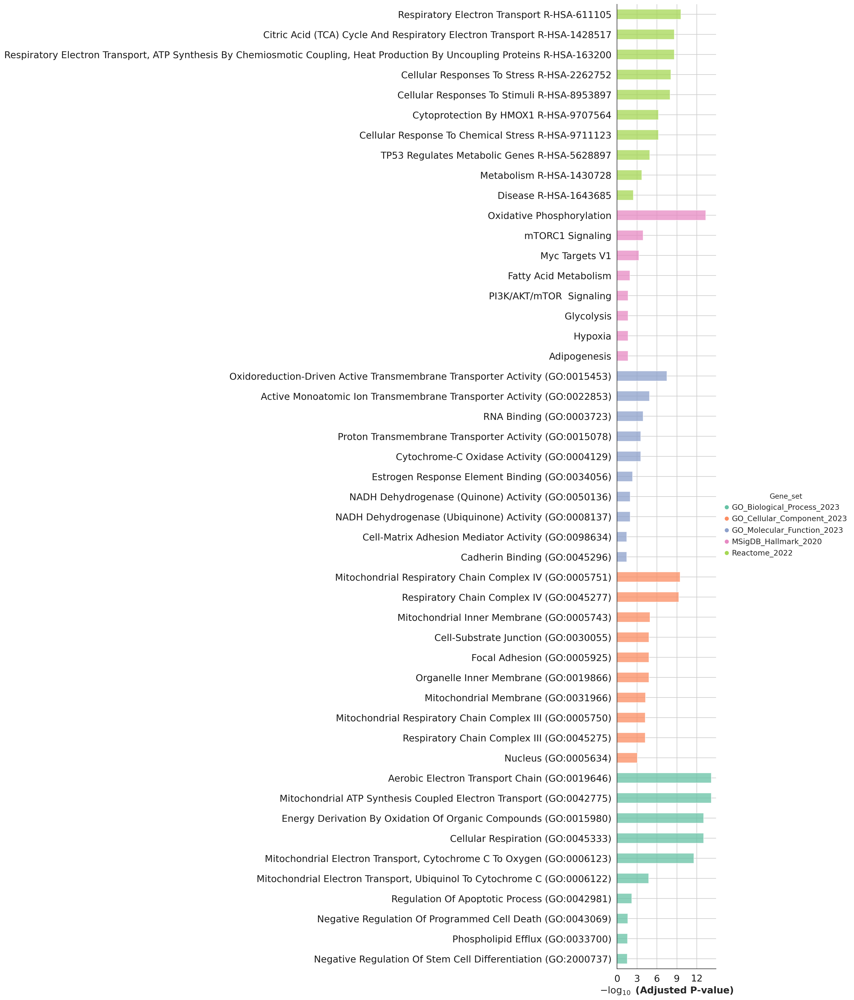

In [234]:
x = gp.barplot(enr_mut_up.results,
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
               color = clr
             )

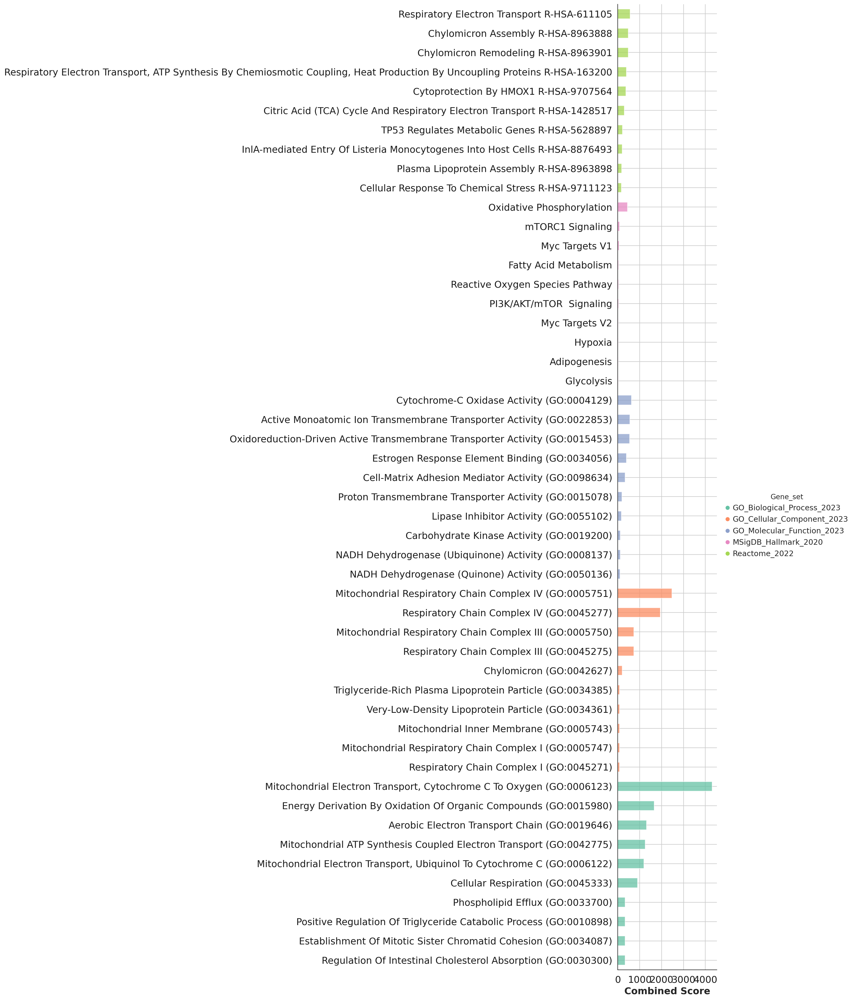

In [235]:
y = gp.barplot(enr_mut_up.results,
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
               color = clr
             )

In [233]:
wt_up['names']

23311     Olfm4
23310      Cd74
23309      Xist
23308    Defa24
23307     Rpl26
          ...  
4           Mt1
3        Lgals2
2          Gas6
1           Mt2
0         Fabp1
Name: names, Length: 500, dtype: object

In [229]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr_wt_up = gp.enrichr(gene_list=wt_up['names'].iloc[0:200], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [230]:
enr_wt_up.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Cytoplasmic Translation (GO:0002181),24/93,1.456524e-27,2.152743e-24,0,0,38.994071,2409.589677,RPL4;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;RPL13A...
1,GO_Biological_Process_2023,Macromolecule Biosynthetic Process (GO:0009059),27/183,6.481339e-24,4.789710e-21,0,0,19.652735,1049.320717,RPL4;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;RPL10A...
2,GO_Biological_Process_2023,Translation (GO:0006412),28/234,3.308430e-22,1.629953e-19,0,0,15.484082,765.848871,RPL4;RPL3;RPL32;RPL31;RPL12;RPLP1;RPLP0;RPL8;R...
3,GO_Biological_Process_2023,Peptide Biosynthetic Process (GO:0043043),24/158,1.152178e-21,4.257298e-19,0,0,20.012890,964.874121,RPL4;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;RPL13A...
4,GO_Biological_Process_2023,Gene Expression (GO:0010467),25/296,2.916639e-16,8.621585e-14,0,0,10.294676,368.250123,RPL4;RPL3;RPL32;RPL31;RPL12;RPLP1;RPLP0;RPL8;R...


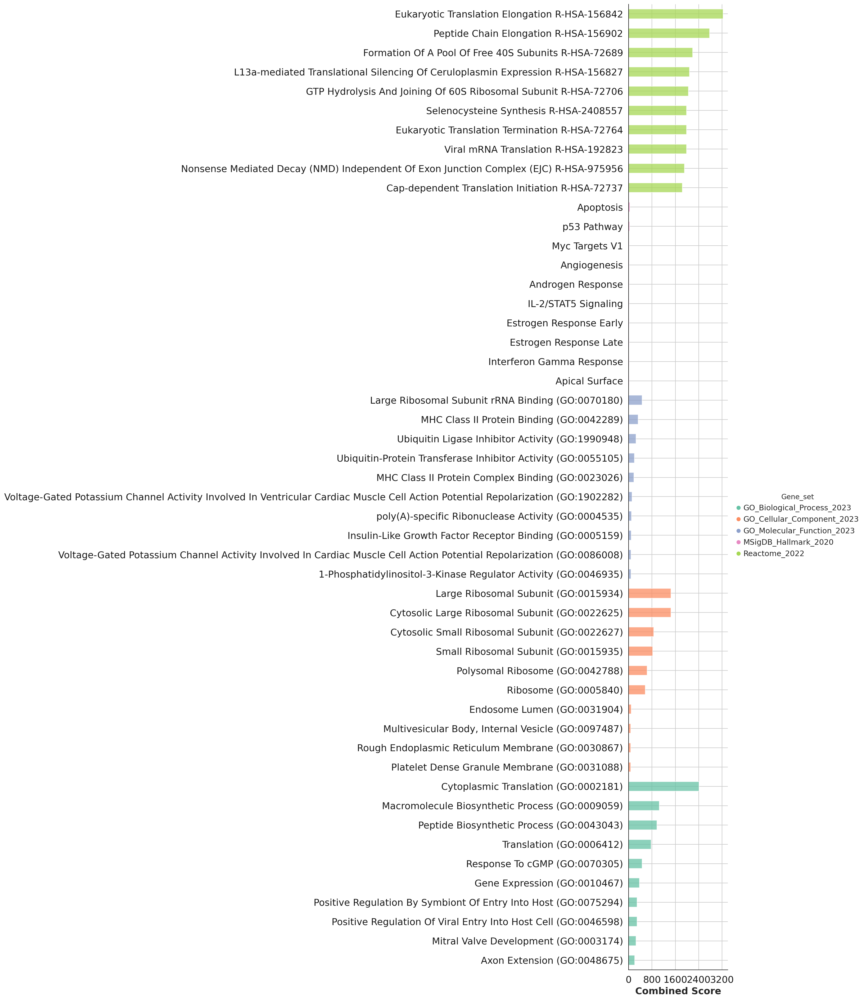

In [232]:
x = gp.barplot(enr_wt_up.results,
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

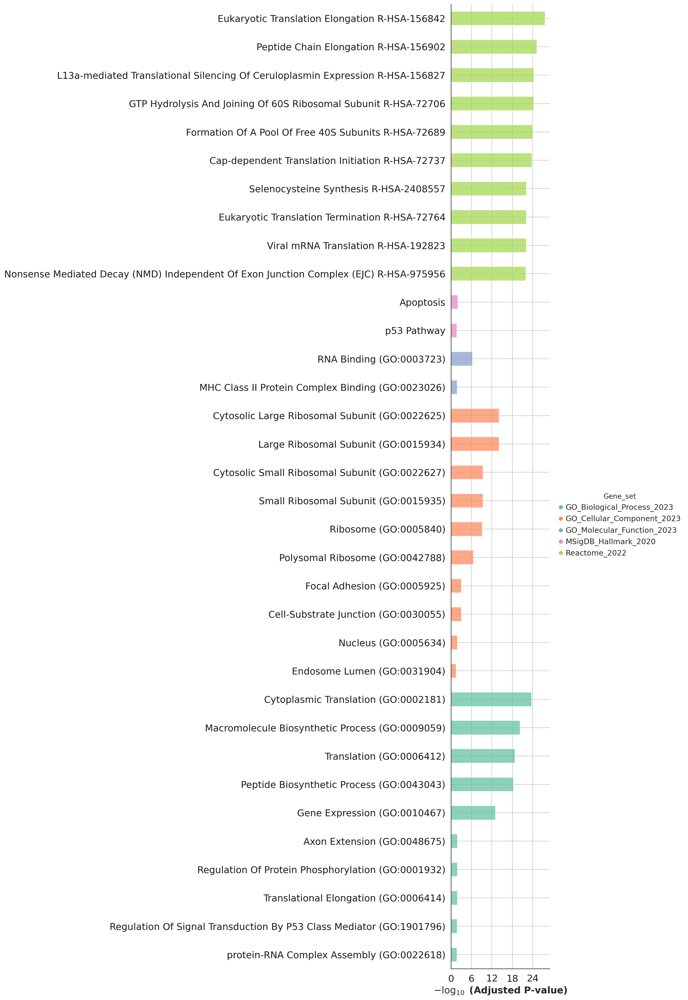

In [236]:
y = gp.barplot(enr_wt_up.results,
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

#### get enrichment bar plots for additional gene sets

In [189]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr_mut_up2 = gp.enrichr(gene_list=mut_up['names'].iloc[0:200], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets2,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [190]:
#enr_mut_up.results.head(5)

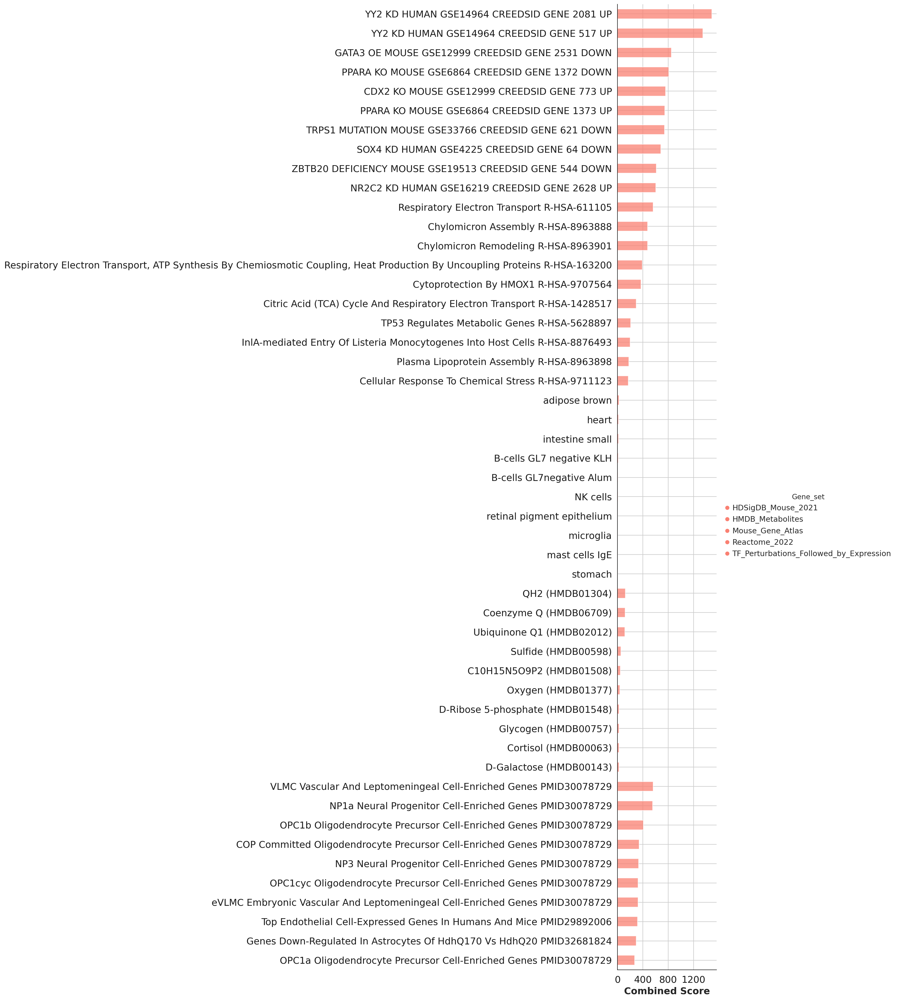

In [191]:
x = gp.barplot(enr_mut_up2.results,
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

In [192]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr_wt_up2 = gp.enrichr(gene_list=wt_up['names'].iloc[0:200], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets2,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [193]:
#enr_wt_up.results.head(5)

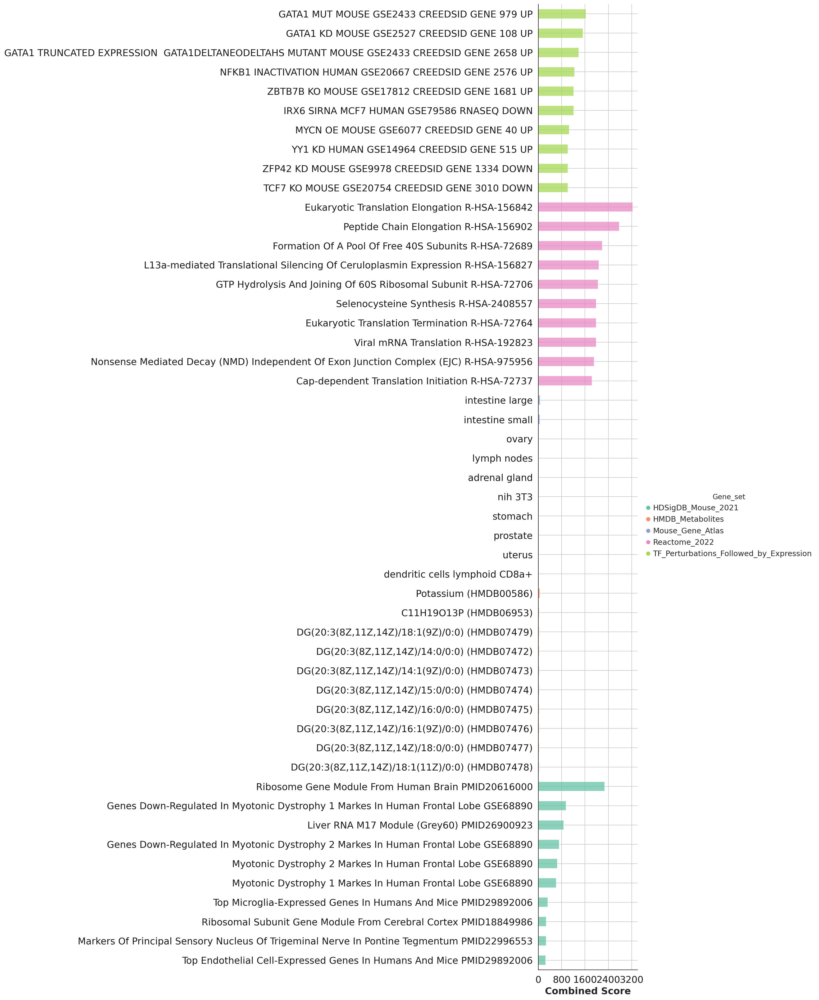

In [224]:
x = gp.barplot(enr_wt_up2.results,
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
              color=clr # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

### Trial 2: get enrichment for traditional gene sets with top 500 genes
- still sorted by scores

In [239]:
mut_up.sort_values( by = 'scores', ascending=False, inplace=True)
mut_up.head()

,logfoldchanges,pvals_adj,pvals,names,scores
0,3.899024,1.805826e-88,2.323901e-92,Fabp1,20.383898
1,4.100955,5.039356e-71,1.729360e-74,Mt2,18.259796
2,3.635256,6.689134e-56,3.730214e-59,Gas6,16.218529
3,1.381510,7.240207e-53,4.658678e-56,Lgals2,15.774528
4,2.006882,7.109687e-44,6.709554e-47,Mt1,14.382031


In [240]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr_mut_up500 = gp.enrichr(gene_list=mut_up['names'].iloc[0:500], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [242]:
enr_mut_up500.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Cytoplasmic Translation (GO:0002181),32/93,4.284575e-28,1.088282e-24,0,0,21.789547,1373.119784,EIF4A2;RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12...
1,GO_Biological_Process_2023,Macromolecule Biosynthetic Process (GO:0009059),37/183,3.692378e-23,4.689320e-20,0,0,10.593479,547.186952,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...
2,GO_Biological_Process_2023,Peptide Biosynthetic Process (GO:0043043),32/158,3.287136e-20,2.783109e-17,0,0,10.513635,471.659361,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...
3,GO_Biological_Process_2023,Translation (GO:0006412),37/234,2.516668e-19,1.598084e-16,0,0,7.830317,335.342554,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...
4,GO_Biological_Process_2023,Gene Expression (GO:0010467),37/296,6.987151e-16,3.549473e-13,0,0,5.936748,207.176405,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...


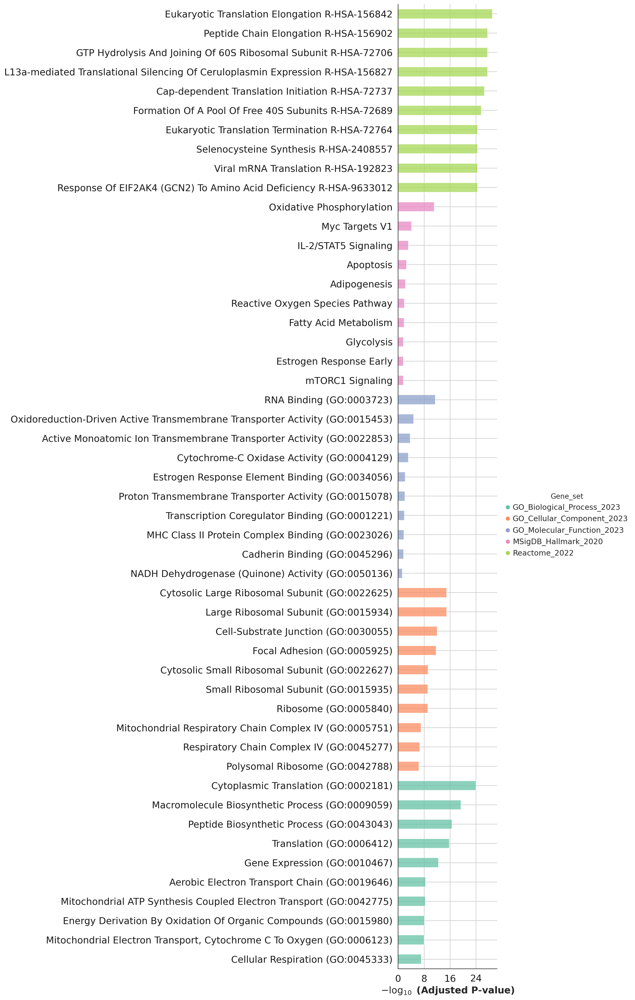

In [243]:
x = gp.barplot(enr_mut_up500.results,
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
               color = clr
             )

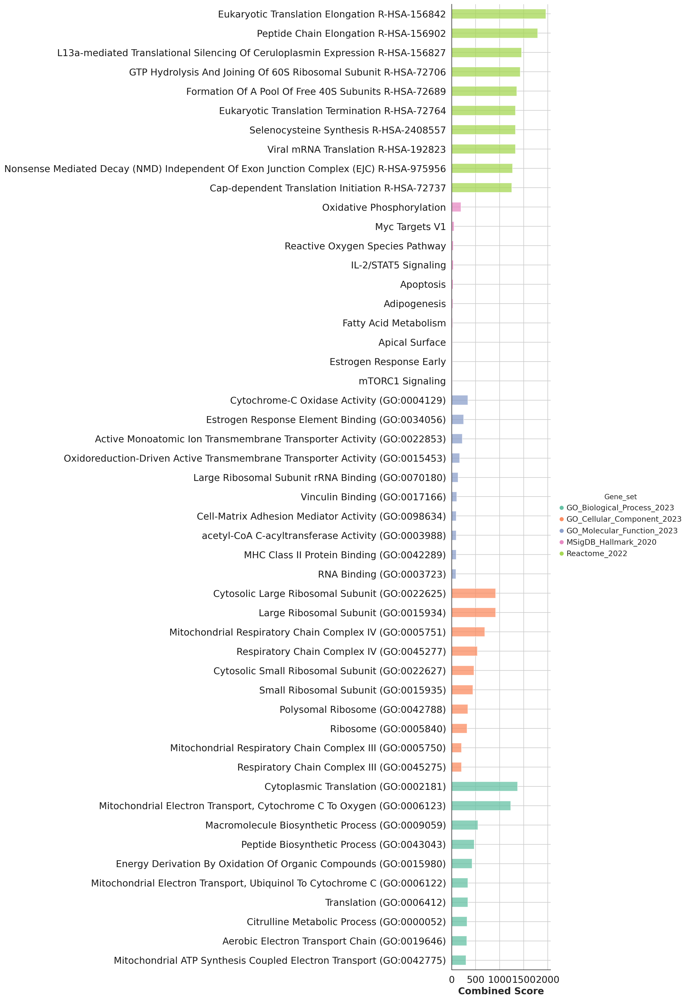

In [244]:
y = gp.barplot(enr_mut_up500.results,
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
               color = clr
             )

In [245]:
wt_up['names']

23311     Olfm4
23310      Cd74
23309      Xist
23308    Defa24
23307     Rpl26
          ...  
4           Mt1
3        Lgals2
2          Gas6
1           Mt2
0         Fabp1
Name: names, Length: 500, dtype: object

In [246]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr_wt_up500 = gp.enrichr(gene_list=wt_up['names'].iloc[0:500], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [247]:
enr_wt_up500.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Cytoplasmic Translation (GO:0002181),32/93,4.284575e-28,1.088282e-24,0,0,21.789547,1373.119784,EIF4A2;RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12...
1,GO_Biological_Process_2023,Macromolecule Biosynthetic Process (GO:0009059),37/183,3.692378e-23,4.689320e-20,0,0,10.593479,547.186952,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...
2,GO_Biological_Process_2023,Peptide Biosynthetic Process (GO:0043043),32/158,3.287136e-20,2.783109e-17,0,0,10.513635,471.659361,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...
3,GO_Biological_Process_2023,Translation (GO:0006412),37/234,2.516668e-19,1.598084e-16,0,0,7.830317,335.342554,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...
4,GO_Biological_Process_2023,Gene Expression (GO:0010467),37/296,6.987151e-16,3.549473e-13,0,0,5.936748,207.176405,RPL4;RPL30;RPL3;RPL32;RPL31;RPLP1;RPL12;RPLP0;...


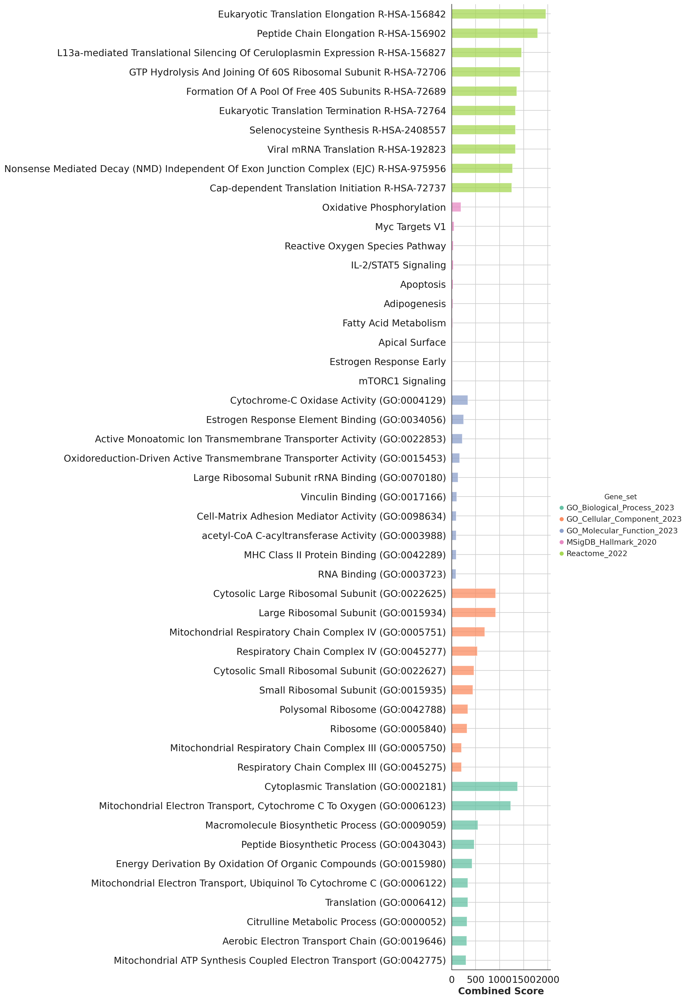

In [248]:
x = gp.barplot(enr_wt_up500.results,
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

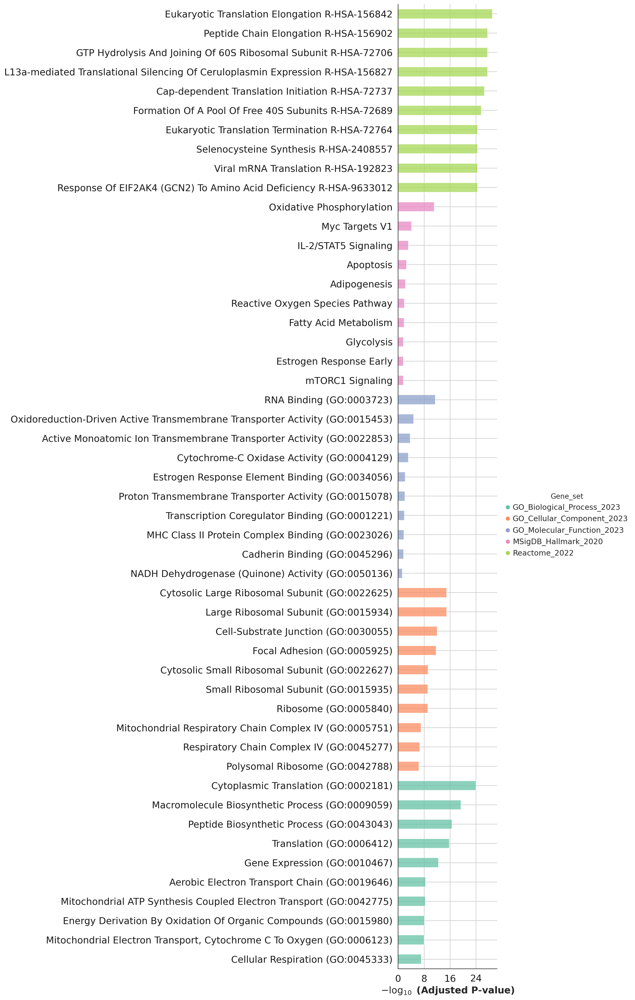

In [249]:
y = gp.barplot(enr_wt_up500.results,
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

### Trial 3: use genes < 0.05 adj pvals and sorted by logfold change

#### get the gene lists

In [28]:
dge.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564014,4.989260e-84,1.070106e-87,Defa24,-19.851477
23307,-2.093729,1.682305e-71,4.329886e-75,Rpl26,-18.335255


In [23]:
dge.shape

(23312, 5)

In [68]:
significant_dge = dge[dge['pvals_adj'] < 0.05 ] 
significant_dge.shape

(1104, 5)

In [69]:
mut_up = significant_dge.sort_values( by = 'logfoldchanges' , ascending= False)
mut_up = mut_up[mut_up['logfoldchanges'] > 0 ]
mut_up.shape

(200, 5)

In [70]:
mut_up.head()

,logfoldchanges,pvals_adj,pvals,names,scores
20,29.162264,1.347892e-13,5.781967e-16,Sall3,8.093825
53,28.312252,2.053962e-07,2.105769e-09,Tmprss6,5.989430
124,27.702232,3.763715e-03,1.023147e-04,Ooep,3.885036
22,7.355401,4.300770e-13,1.918669e-15,Il2rb,7.946492
99,7.119869,4.041267e-04,7.801004e-06,Kif26a,4.470574


In [79]:
wt_up = significant_dge.sort_values( by = 'logfoldchanges' , ascending= True)
wt_up = wt_up[wt_up['logfoldchanges'] < 0 ] 
wt_up.shape

(904, 5)

In [72]:
#wt_up = wt_up.iloc[0:200]
#wt_up.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23166,-29.434116,1.868063e-08,1.490476e-10,Hcn4,-6.406347
23032,-28.983948,5.292352e-05,8.309298e-07,Olfr1229,-4.927959
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23180,-7.679943,4.178228e-09,2.975231e-11,Defa20,-6.647792


In [73]:
wt_up.shape

(200, 5)

#### run enrichment

In [74]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
t3_enr_mutup = gp.enrichr(gene_list=mut_up['names'], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [80]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
t3_enr_wtup = gp.enrichr(gene_list=wt_up['names'], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

#### plot enrichment

In [83]:
t3_enr_mutup.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Aerobic Electron Transport Chain (GO:0019646),19/68,9.142549e-23,1.016120e-19,0,0,42.312437,2147.208820,COX8A;NDUFB9;NDUFB8;NDUFB6;UQCRB;NDUFA5;NDUFB4...
1,GO_Biological_Process_2023,Mitochondrial ATP Synthesis Coupled Electron T...,19/70,1.702043e-22,1.016120e-19,0,0,40.649009,2037.533301,COX8A;NDUFB9;NDUFB8;NDUFB6;UQCRB;NDUFA5;NDUFB4...
2,GO_Biological_Process_2023,Cellular Respiration (GO:0045333),19/85,1.001921e-20,3.987644e-18,0,0,31.386740,1445.352583,COX8A;NDUFB9;NDUFB8;NDUFB6;UQCRB;NDUFA5;NDUFB4...
3,GO_Biological_Process_2023,Energy Derivation By Oxidation Of Organic Comp...,12/43,8.384337e-15,2.502725e-12,0,0,40.704873,1319.343079,COX8A;UQCRB;UQCRQ;CYCS;COX7A2;UQCR11;UQCR10;CO...
4,GO_Biological_Process_2023,"Mitochondrial Electron Transport, Cytochrome C...",8/16,1.043932e-12,2.492910e-10,0,0,103.083333,2843.865755,COX8A;CYCS;COX7A2;COX6A1;COX6C;COX5A;COX7C;COX6B1


plot based on adjusted pvals

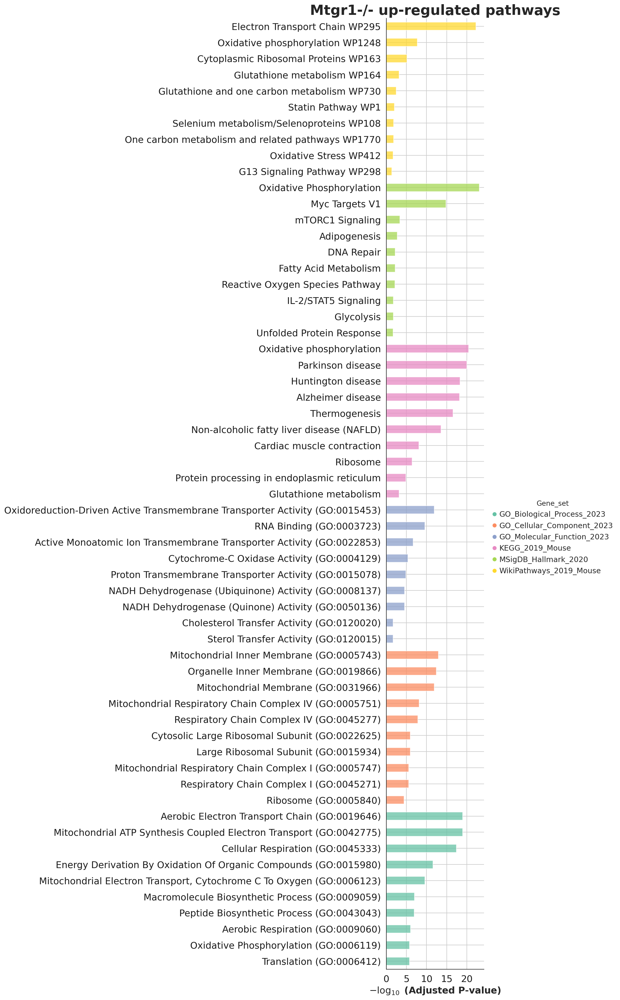

In [76]:
x = gp.barplot(t3_enr_mutup.results,
               title = 'Mtgr1-/- up-regulated pathways', 
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

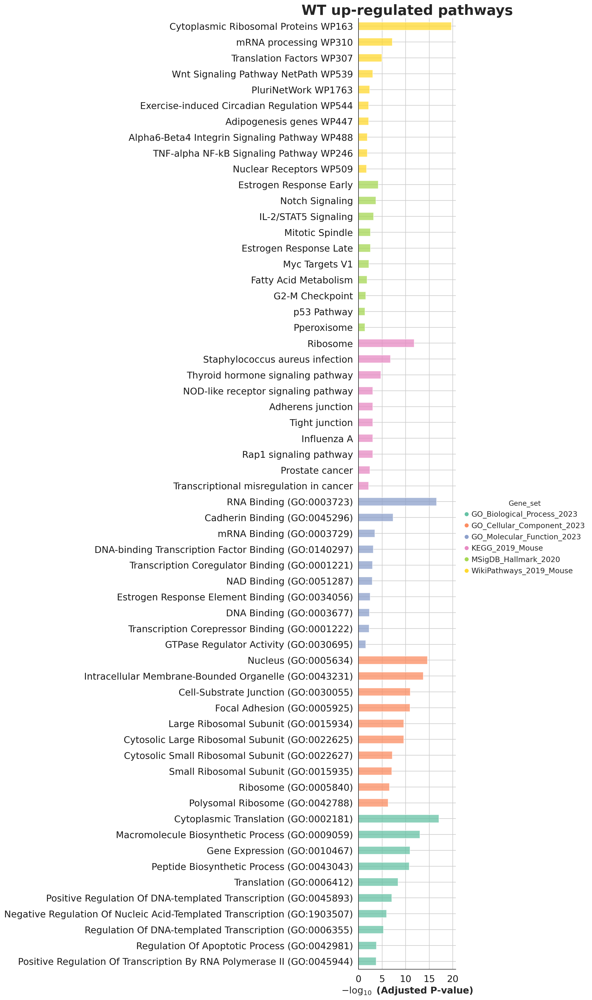

In [82]:
y = gp.barplot(t3_enr_wtup.results,
               title = 'WT up-regulated pathways', 
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

plot based on combined scores

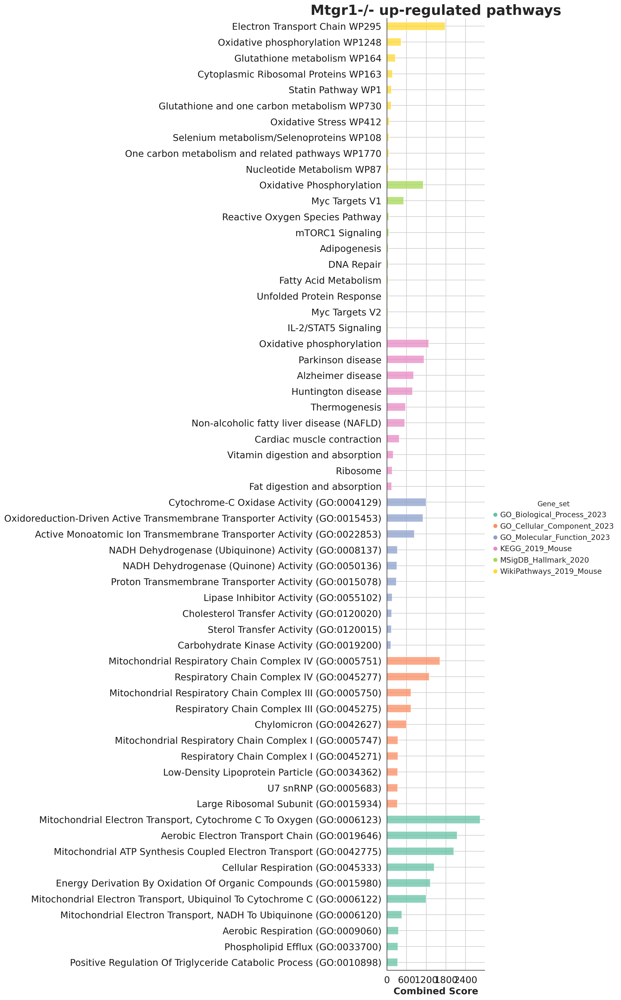

In [84]:
x2 = gp.barplot(t3_enr_mutup.results,
               title = 'Mtgr1-/- up-regulated pathways', 
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

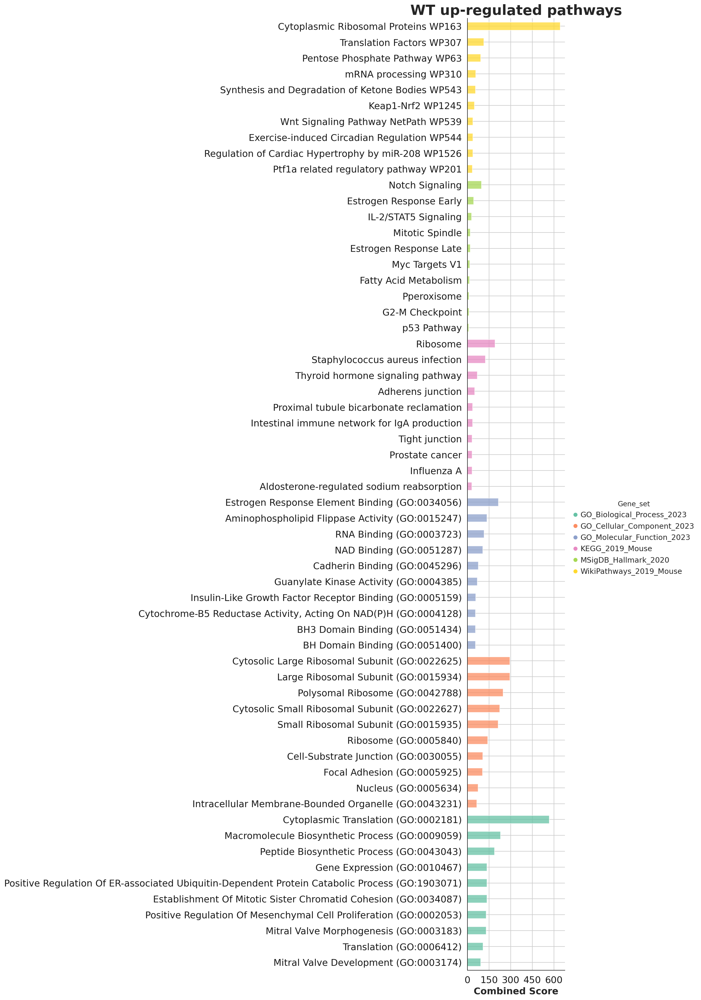

In [85]:
y2 = gp.barplot(t3_enr_wtup.results,
               title = 'WT up-regulated pathways', 
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

### Trial 4: use genes < 0.05 adj pvals and sorted by scores

In [23]:
dge = pd.read_csv("./stem_dge.csv", header = 0, index_col= 0 )
dge.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564014,4.989260e-84,1.070106e-87,Defa24,-19.851477
23307,-2.093729,1.682305e-71,4.329886e-75,Rpl26,-18.335255


In [24]:
dge = dge[dge['pvals_adj'] < 0.05 ] 

In [25]:
mutup = dge[dge['scores'] > 0 ]
mutup.shape

(202, 5)

In [26]:
mutup.sort_values( by = 'scores', ascending= False, inplace= True)
mutup.head()

/tmp/ipykernel_980009/2950484740.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mutup.sort_values( by = 'scores', ascending= False, inplace= True)


,logfoldchanges,pvals_adj,pvals,names,scores
0,3.899024,1.805826e-88,2.323901e-92,Fabp1,20.383898
1,4.100955,5.039356e-71,1.729360e-74,Mt2,18.259796
2,3.635256,6.689134e-56,3.730214e-59,Gas6,16.218529
3,1.381510,7.240207e-53,4.658678e-56,Lgals2,15.774528
4,2.006882,7.109687e-44,6.709554e-47,Mt1,14.382031


In [27]:
wtup = dge[dge['scores'] < 0 ]

In [28]:
wtup.sort_values( by = 'scores', ascending= True, inplace= True)

/tmp/ipykernel_980009/214779821.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  wtup.sort_values( by = 'scores', ascending= True, inplace= True)


In [29]:
wtup.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564014,4.989260e-84,1.070106e-87,Defa24,-19.851477
23307,-2.093729,1.682305e-71,4.329886e-75,Rpl26,-18.335255


In [30]:
wtup.shape

(902, 5)

In [31]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
t4_enr_mutup = gp.enrichr(gene_list=mutup['names'], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [32]:
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
t4_enr_wtup = gp.enrichr(gene_list=wtup['names'], # or "./tests/data/gene_list.txt",
                 gene_sets=gene_sets,
                 organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

#### plot enrichment

In [33]:
t4_enr_mutup.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,Aerobic Electron Transport Chain (GO:0019646),19/68,1.109315e-22,1.234741e-19,0,0,41.845768,2115.434509,COX8A;NDUFB9;NDUFB8;NDUFB6;UQCRB;NDUFA5;NDUFB4...
1,GO_Biological_Process_2023,Mitochondrial ATP Synthesis Coupled Electron T...,19/70,2.064785e-22,1.234741e-19,0,0,40.200686,2007.294452,COX8A;NDUFB9;NDUFB8;NDUFB6;UQCRB;NDUFA5;NDUFB4...
2,GO_Biological_Process_2023,Cellular Respiration (GO:0045333),19/85,1.213703e-20,4.838628e-18,0,0,31.040570,1423.459255,COX8A;NDUFB9;NDUFB8;NDUFB6;UQCRB;NDUFA5;NDUFB4...
3,GO_Biological_Process_2023,Energy Derivation By Oxidation Of Organic Comp...,12/43,9.452551e-15,2.826313e-12,0,0,40.272326,1300.493754,COX8A;UQCRB;UQCRQ;CYCS;COX7A2;UQCR11;UQCR10;CO...
4,GO_Biological_Process_2023,"Mitochondrial Electron Transport, Cytochrome C...",8/16,1.131228e-12,2.705897e-10,0,0,102.010309,2806.070768,COX8A;CYCS;COX7A2;COX6A1;COX6C;COX5A;COX7C;COX6B1


plot based on adjusted pvals

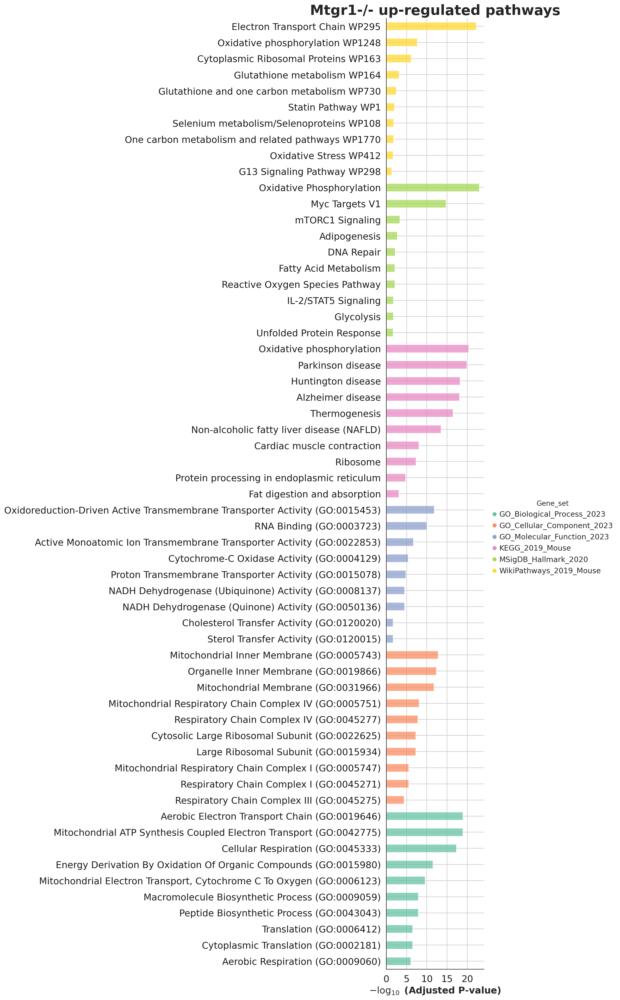

In [34]:
x = gp.barplot(t4_enr_mutup.results,
               title = 'Mtgr1-/- up-regulated pathways', 
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

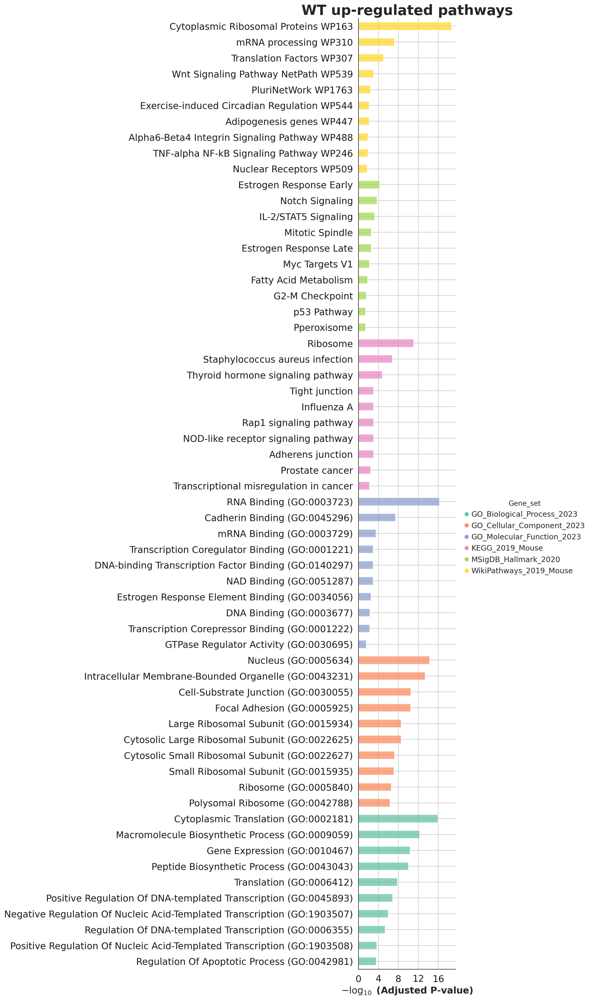

In [35]:
y = gp.barplot(t4_enr_wtup.results,
               title = 'WT up-regulated pathways', 
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

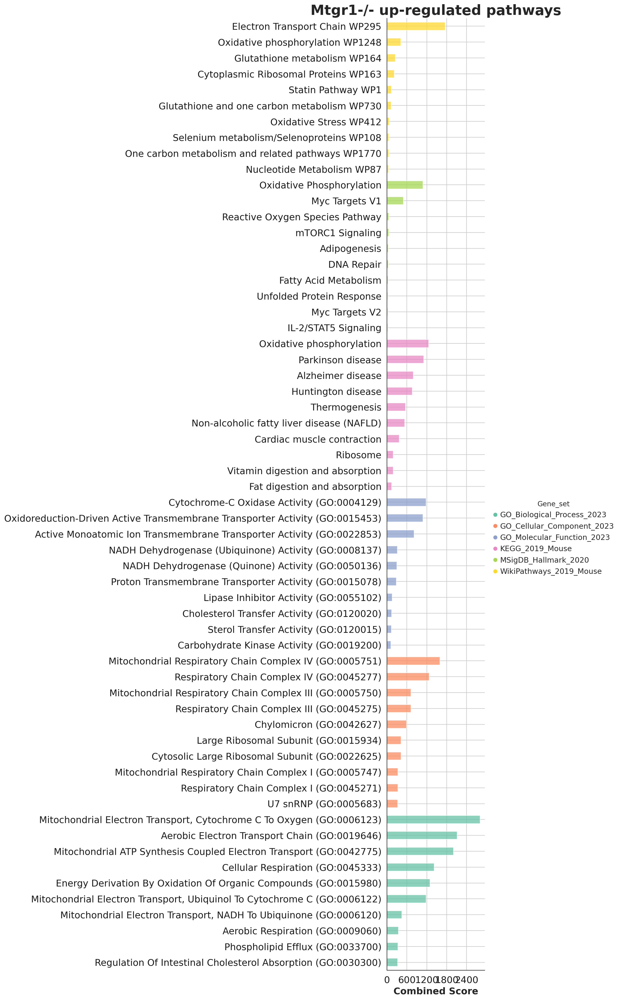

In [36]:
x = gp.barplot(t4_enr_mutup.results,
               title = 'Mtgr1-/- up-regulated pathways', 
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

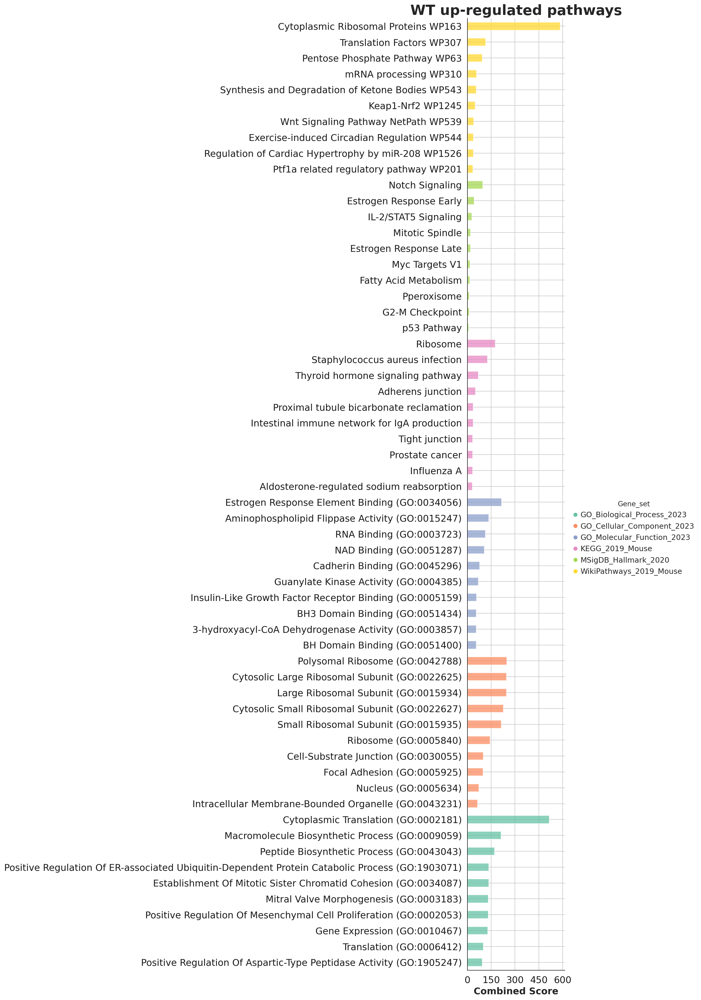

In [38]:
x = gp.barplot(t4_enr_wtup.results,
               title = 'WT up-regulated pathways', 
              column="Combined Score",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10,
              top_term=10,
              figsize=(3,30),
               color = clr
              #color=['darkred', 'darkblue'] # set colors for group
              #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
             )

### Trial 5: finialize with GOBP, Wiki and KEGG with top 50 terms

#### get ranked gene list

In [44]:
t5_gene_sets = [ 'GO_Biological_Process_2023', 'WikiPathways_2019_Mouse', 'KEGG_2019_Mouse']

In [45]:
significant_dge = dge[dge['pvals_adj'] < 0.05 ] 
significant_dge.shape

(1104, 5)

In [46]:
mut_up = significant_dge.sort_values( by = 'logfoldchanges' , ascending= False)
mut_up = mut_up[mut_up['logfoldchanges'] > 0 ]
mut_up.shape

(200, 5)

In [47]:
mut_up.head()

,logfoldchanges,pvals_adj,pvals,names,scores
20,29.162264,1.347892e-13,5.781967e-16,Sall3,8.093825
53,28.312252,2.053962e-07,2.105769e-09,Tmprss6,5.989430
124,27.702232,3.763715e-03,1.023147e-04,Ooep,3.885036
22,7.355401,4.300770e-13,1.918669e-15,Il2rb,7.946492
99,7.119869,4.041267e-04,7.801004e-06,Kif26a,4.470574


In [48]:
wt_up = significant_dge.sort_values( by = 'logfoldchanges' , ascending= True)
wt_up = wt_up[wt_up['logfoldchanges'] < 0 ] 
wt_up.shape

(904, 5)

In [49]:
#wt_up = wt_up.iloc[0:200]
#wt_up.head()

In [73]:
wt_up.shape

(200, 5)

#### run enrichment

In [52]:
print( t5_gene_sets)

['GO_Biological_Process_2023', 'WikiPathways_2019_Mouse', 'KEGG_2019_Mouse']


In [53]:
t5_mut_enr_ls = []

In [54]:
for i in range(len( t5_gene_sets)):
    
    er = gp.enrichr(gene_list=mut_up['names'], # or "./tests/data/gene_list.txt",
                     gene_sets=[t5_gene_sets[i]],
                     organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                     outdir=None, # don't write to disk
                    )
    t5_mut_enr_ls.append( er)

In [55]:
t5_wt_enr_ls = []

In [56]:
for i in range(len( t5_gene_sets)):
    
    er = gp.enrichr(gene_list=wt_up['names'], # or "./tests/data/gene_list.txt",
                     gene_sets=[t5_gene_sets[i]],
                     organism='mouse', # don't forget to set organism to the one you desired! e.g. Yeast
                     outdir=None, # don't write to disk
                    )
    t5_wt_enr_ls.append( er)

88

#### plot enriched terms
- top 50 significant terms 
- separate library

In [63]:
significant_term = t5_mut_enr_ls[0].results[ t5_mut_enr_ls[0].results['Adjusted P-value'] < 0.05 ]

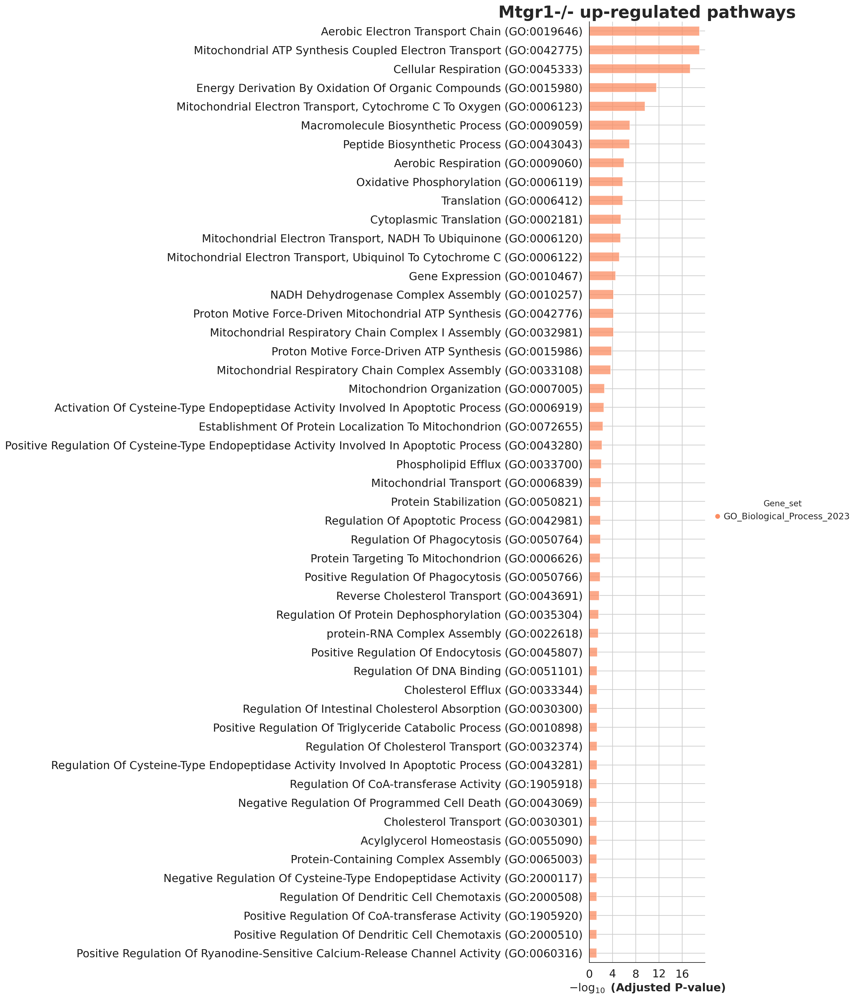

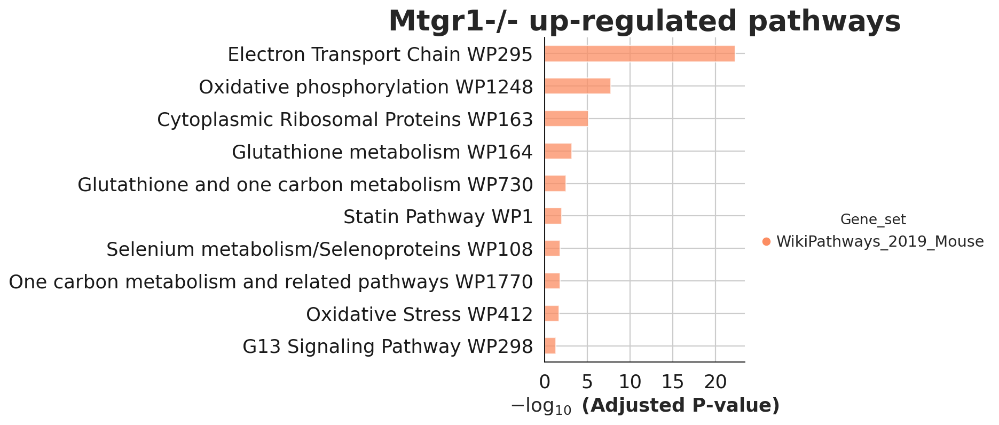

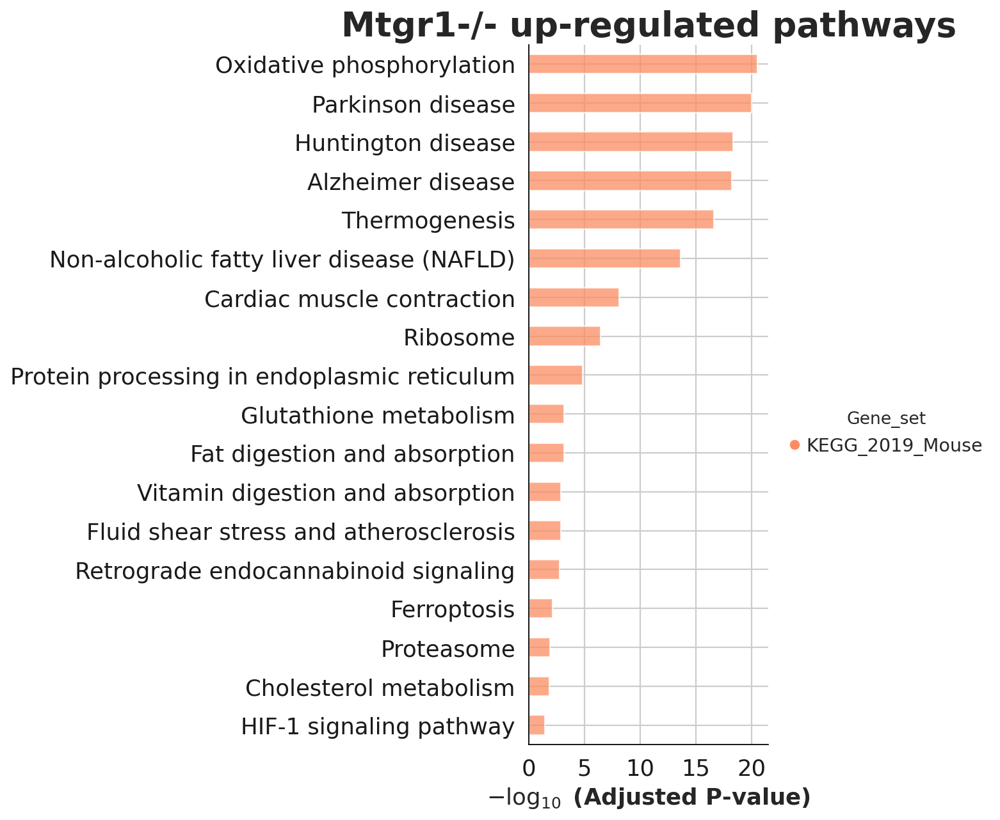

In [70]:
for er in t5_mut_enr_ls:
    significant_term = er.results[ er.results['Adjusted P-value'] < 0.05 ]
    num_terms = min( 50, significant_term.shape[0] )
    x = gp.barplot(er.results,
                   title = 'Mtgr1-/- up-regulated pathways', 
                  column="Adjusted P-value",
                  group='Gene_set', # set group, so you could do a multi-sample/library comparsion
                  size=10,
                  top_term=50,
                  figsize=(3,round( 0.5 * num_terms) ),
                   color = clr_t5[1]
                  #color=['darkred', 'darkblue'] # set colors for group
                  #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
                 )

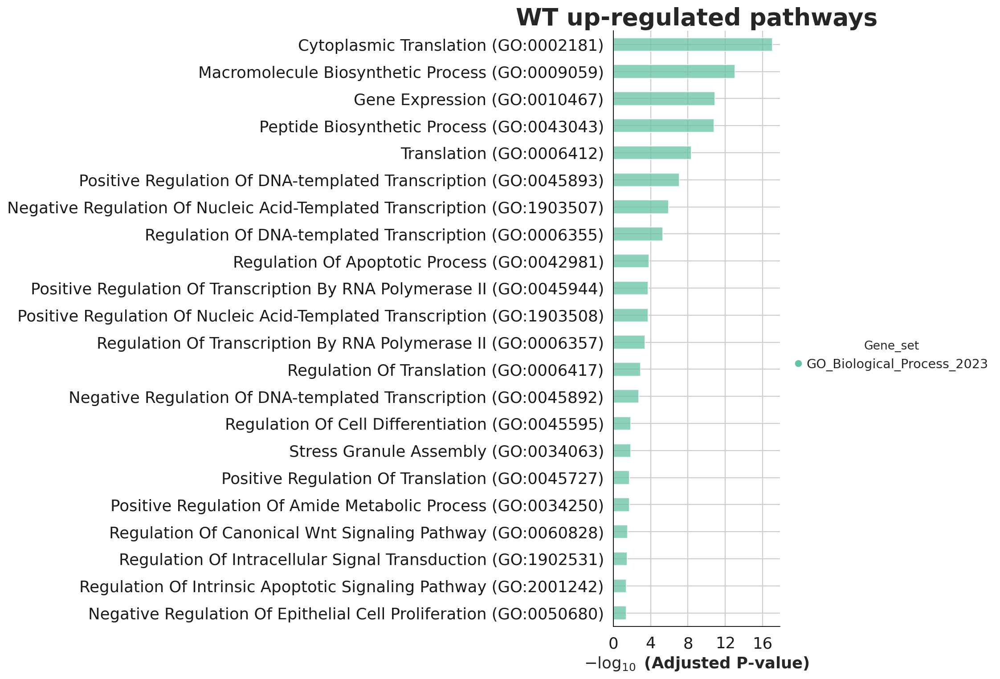

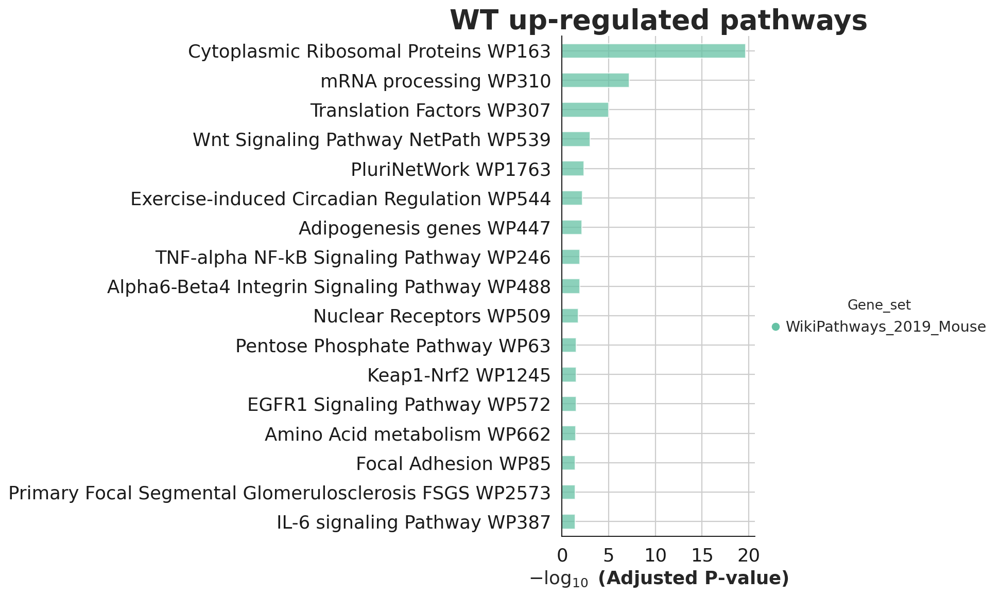

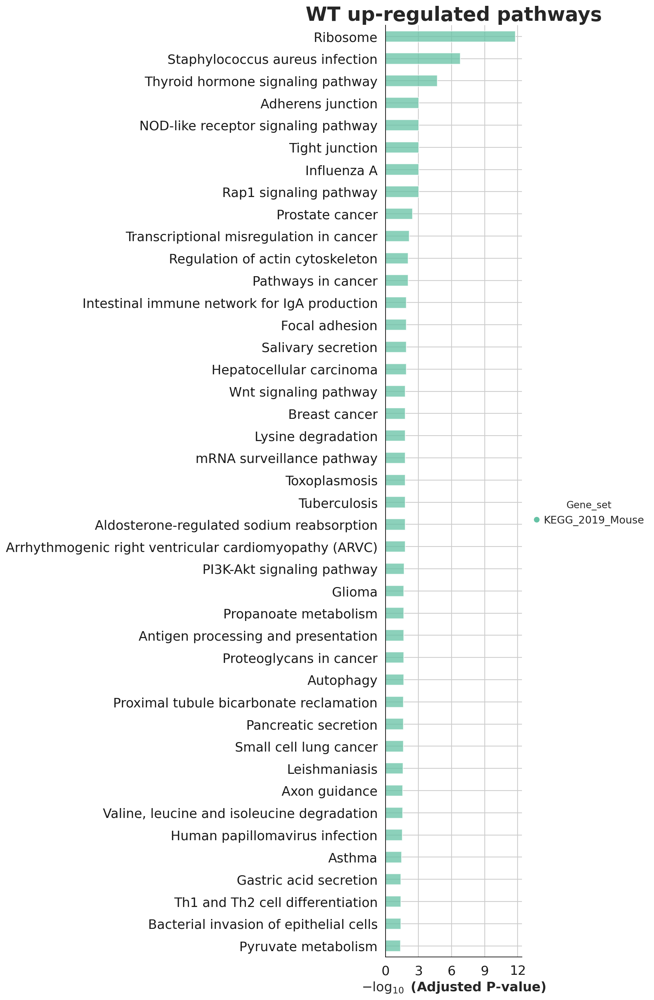

In [67]:
for er in t5_wt_enr_ls:
    significant_term = er.results[ er.results['Adjusted P-value'] < 0.05 ]
    num_terms = min( 50, significant_term.shape[0] )
    x = gp.barplot(er.results,
                   title = 'WT up-regulated pathways', 
                  column="Adjusted P-value",
                  group='Gene_set', # set group, so you could do a multi-sample/library comparsion
                  size=10,
                  top_term=50,
                  figsize=(3,round( 0.5 * num_terms) ),
                   color = clr_t5
                  #color=['darkred', 'darkblue'] # set colors for group
                  #color = {'KEGG_2021_Human': 'salmon', 'MSigDB_Hallmark_2020':'darkblue'}
                 )

## save data

In [40]:
dat_ls2 = [dat1a, dat2a, dat3, dat5]

In [45]:
print( filenames )

['10868_1.h5ad', '10868_2.h5ad', '10868_3.h5ad', '10868_4.h5ad', '10868_5.h5ad']


In [46]:
filenames2 = ['10868_1.h5ad', '10868_2.h5ad', '10868_3.h5ad', '10868_5.h5ad']

In [51]:
for i in range(len( dat_ls2)):
    d = dat_ls2[i]
    print( filenames2[i] )
    d.X = d.raw.X
    print( d.X.sum(axis = 1)[0:5] )
    d.write( "./new_sample_10868_filtered/"+ filenames2[i] , compression = 'gzip' )

10868_1.h5ad
[80471. 75901. 70469. 67803. 65841.]
10868_2.h5ad
[55894. 53991. 53560. 49773. 47660.]
10868_3.h5ad
[40038. 38935. 33323. 30162. 29648.]
10868_5.h5ad
[65981. 59557. 53141. 50763. 49964.]


In [116]:
dge_res.to_csv("./stem_dge.csv", header = True, index = True)

In [250]:
dge_res.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
0,3.899024,1.805826e-88,2.323901e-92,Fabp1,20.383898
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564013,4.989260e-84,1.070106e-87,Defa24,-19.851477


In [251]:
dge_weg_gsea_input = dge_res[ [ 'names', 'scores'] ]

In [252]:
dge_weg_gsea_input.to_csv("./stem_dge_webGSEA.csv", header = False, index = False, sep = ')

save dge score-sorted

In [7]:
dge = pd.read_csv("./stem_dge.csv", header = 0, index_col= 0 )
dge.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564014,4.989260e-84,1.070106e-87,Defa24,-19.851477
23307,-2.093729,1.682305e-71,4.329886e-75,Rpl26,-18.335255


In [8]:
dge.sort_values( by = 'scores', ascending= True, inplace=True)
dge.head()

,logfoldchanges,pvals_adj,pvals,names,scores
23311,-8.849787,2.472296e-149,1.060525e-153,Olfm4,-26.409687
23310,-4.056441,4.155503e-104,3.565119e-108,Cd74,-22.094563
23309,-31.435600,1.245169e-87,2.136529e-91,Xist,-20.275032
23308,-3.564014,4.989260e-84,1.070106e-87,Defa24,-19.851477
23307,-2.093729,1.682305e-71,4.329886e-75,Rpl26,-18.335255


In [9]:
dge_web = dge[['names', 'scores']]

In [10]:
dge_web.to_csv( "./stem_dge_web_score_sorted.tsv", sep = '\t', header = False, index = False)

save subsampled data

In [164]:
# relab is relabelled subsampled combined dataset that has sample 4 removed 
relab.X = relab.raw.X 
relab.X.sum(axis = 1)

array([ 2377.,  1005., 12946., ...,   887.,   885.,   883.], dtype=float32)

In [167]:
relab.obs.drop( 'treatment', axis = 1, inplace=True)

In [168]:
relab

AnnData object with n_obs × n_vars = 9010 × 23312
    obs: 'sample', 'cell_type', 'cytotrace', 'leiden', 'condition'
    var: 'mean', 'std'
    uns: 'pca', 'neighbors', 'umap', 'sample_colors', 'cell_type_colors', 'leiden', 'leiden_colors', 'treatment_colors', 'condition_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'arcsinh', 'raw_counts'
    obsp: 'distances', 'connectivities'

In [170]:
relab.write( "./new_sample_10868_filtered/subsampled_combine_WT_Mut.h5ad", compression = 'gzip' )

## check if the savings are correct

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


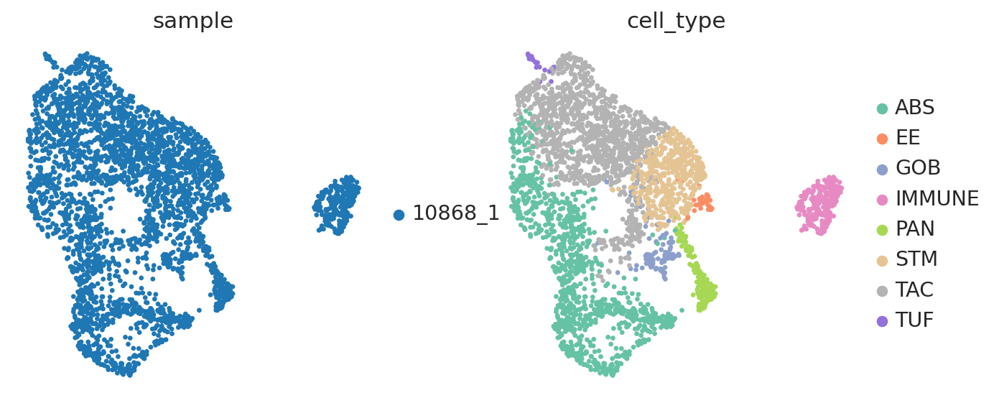

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


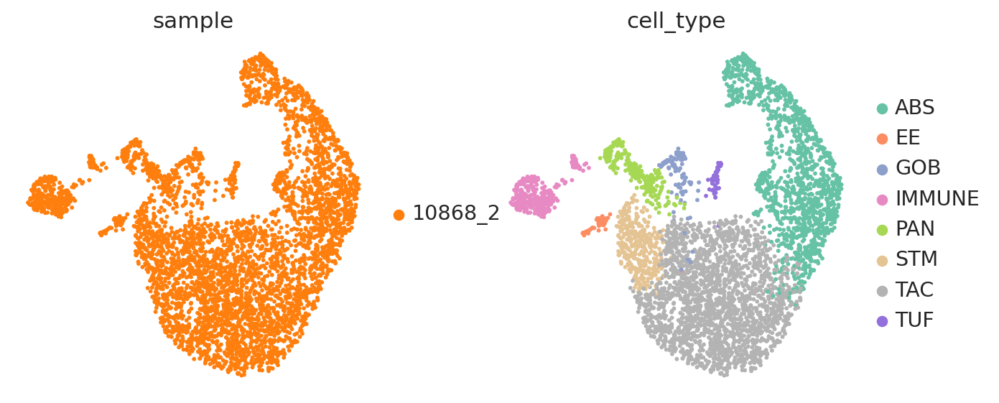

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


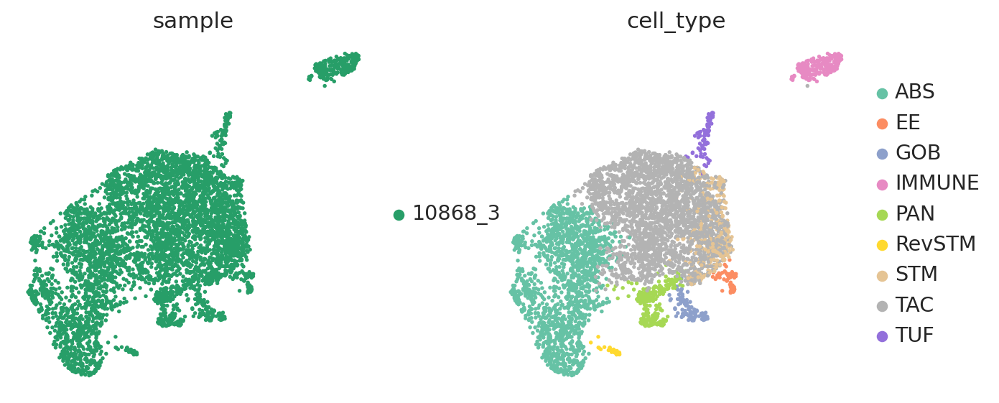

/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/lucy/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


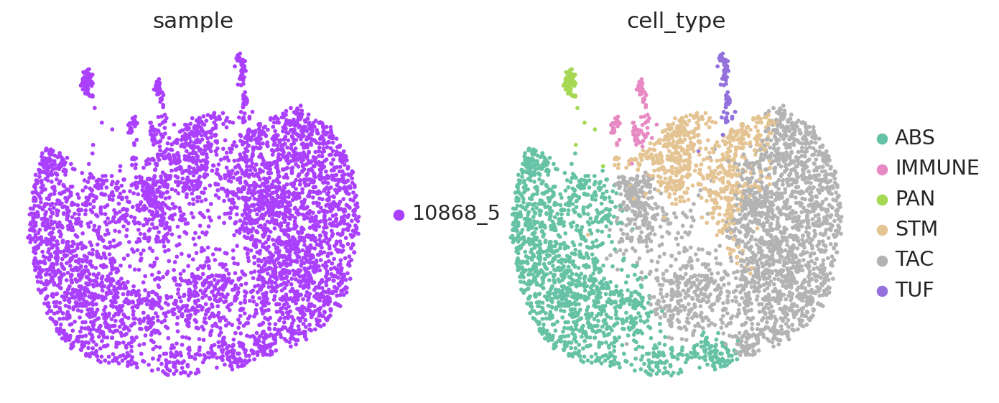

In [52]:
for i in range(len(filenames2)):
    f = filenames2[i]
    d = sc.read("./new_sample_10868_filtered/" + f)
    sc.pl.umap( d, color = ['sample', 'cell_type'] )